# DATASET 3

## Descrição dos dados

Neste dataset encontram-se **530 amostras** de pacientes portadores de gliomas, sendo este, no fundo, composto por 3 datasets diferentes data_patient, data_sample e data_glioma.

No dataset **data_patient**, podem ser observados atributos relativos a históricos clinicos de **515 pacientes**, bem como o seu diagnostico e o desfecho do seu caso.

Relativamente ao dataset **data_sample**, verifica-se a presença de informações relativas às dimensões da amostra e à sua natureza.

Por fim, no dataset **data_glioma** averigua-se a expressão de cada um dos genes considerados para cada amostra obtida.


## Análise do contexto

### Células Gliais

As **células gliais**, fundamentais no sistema nervoso, desempenham funções críticas para o suporte e manutenção dos neurónios, além de participarem ativamente na resposta imunológica e reparação de tecidos. No entanto, alterações nesses elementos essenciais podem levar ao desenvolvimento de **gliomas**, os tumores primários mais comuns do cérebro e da medula espinhal, representando 33% de todos os tumores cerebrais.

### Gliomas

A classificação dos **gliomas**, segundo a **Organização Mundial da Saúde (OMS)**, é feita em quatro graus, baseando-se na atividade celular e agressividade do tumor.

O Grau I é considerado o mais leve e, muitas vezes, tratável com cirurgia. 

Já os **Graus II e III**, que serão o foco deste estudo, representam um desafio maior. Os gliomas de Grau II, incluindo astrocitomas, oligodendrogliomas e oligoastrocitomas mistos, são tumores bem diferenciados e de crescimento mais lento, porém com risco de recorrência e progressão para formas mais agressivas. Os gliomas de Grau III, como os astrocitomas anaplásicos, oligodendrogliomas anaplásicos e oligoastrocitomas anaplásicos, são mais agressivos e apresentam uma taxa de crescimento mais rápida, tornando a ressecção completa desafiadora [1].

Por fim, os gliomas de Grau IV contêm uma probabilidade de infiltração no tecido cerebral bastante alta, possuindo crescimento avançado e sintomas altamente agressivos [2].

### Alterações Genéticas

Os datasets aprofundam-se especificamente nos gliomas de Graus II e III, focando-se nas alterações genéticas associadas a estes tipos de tumores. Alterações em genes como TP53, IDH1/2, ATRX e TERT são frequentemente observadas nesses graus de gliomas e têm implicações significativas tanto no diagnóstico quanto no prognóstico [3]. 

Essas mutações genéticas não apenas contribuem para a progressão e agressividade dos gliomas, mas também são cruciais para guiar estratégias de tratamento personalizadas. Compreender estas alterações genéticas fornece uma base sólida para avançar no tratamento e na gestão desses desafiadores tumores cerebrais.

### Relação entre Gliomas e Genética

Para a identificação da existência de glioma ou, mais especificamente, do seu grau em amostras, é utilizada uma contabilização do número de mutações associadas a um ou mais  genes que atuam como biomarcadores. Comumente, esses genes estão associados a proteínas ou outros compostos que controlam processos associados ao ciclo ou diferenciação celular. 

Os gliomas do tipo II são comumente  identificados por mutações ao nível dos genes IDH1, cuja mutação origina uma substância patogénica que altera a metilação do DNA [4], CIC, que codifica um repressor transcricional [5], TP53, que codifica uma proteína inibidora da proliferação celular [6], do gene NOTCH1, cujo composto resultante interfere na diferenciação celular [7] e ainda do PIK3CA, que origina uma enzima que também desempenha um papel importante no controlo da proliferação celular [8][9].

Por sua vez, nos gliomas tipo III, estes podem ser astrocitomas anaplásticos e ependimomas anaplásticos 1 [1]. Neste grau de gliomas, são visíveis mais mutações nos genes IDH1, TP53 e CIC, como verificado nos gliomas de grau II e ainda nos genes ATRX, um gene cujo composto regula a transcrição proteica [10] e também no CDKN2A, que codifica um inibidor do ciclo celular [11][12]. 

## Objetivo do Projeto

Este projeto tem como objetivo explorar um conjunto de dados relacionados a gliomas e mutações genéticas, utilizando técnicas de **análise de dados**, **redução de dimensionalidade**, **_clustering_** e **_Machine Learning_ (ML)**. 

No final do projeto, espera-se obter **_insights_ valiosos sobre a relação entre estes dados**, bem como **desenvolver modelos preditivos capazes de identificar o grau de agressividade de gliomas** a partir das suas características associadas.

## Bibliotecas

In [1]:
import pandas as pd
import numpy as np
from sklearn import preprocessing
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.feature_selection import VarianceThreshold
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectPercentile, f_classif
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import homogeneity_score, completeness_score, v_measure_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_predict

## Secção 1

Descrever e caraterizar os dados
atribuídos de acordo com a documentação/ literatura existente

### Leitura dos dados

Inicialmente, foi carregado o dataset referente à expressão genética em cada amostra, para um conjunto de 20531 genes e 531 amostras.

In [2]:
data_glioma = pd.read_csv("data_RNA_Seq_v2_expression_median.txt", sep='\t', index_col = 0)

In [3]:
data_glioma.shape

(20531, 531)

Podem, então, ser observadas as primeiras 5 linhas do dataset referido. Averigua-se que alguns genes apresentam variações elevadas. Por exemplo, para o gene TIMM23 encontramos valores, neste excerto, entre 386.1776 e 845.8150, porém, estas variações serão avaliadas em maior detalhe mais à frente neste estudo.

In [4]:
data_glioma.head()

,Entrez_Gene_Id,TCGA-CS-4938-01,TCGA-CS-4941-01,TCGA-CS-4942-01,TCGA-CS-4943-01,TCGA-CS-4944-01,TCGA-CS-5390-01,TCGA-CS-5393-01,TCGA-CS-5394-01,TCGA-CS-5395-01,...,TCGA-VW-A8FI-01,TCGA-W9-A837-01,TCGA-WH-A86K-01,TCGA-WY-A858-01,TCGA-WY-A859-01,TCGA-WY-A85A-01,TCGA-WY-A85B-01,TCGA-WY-A85C-01,TCGA-WY-A85D-01,TCGA-WY-A85E-01
Hugo_Symbol,,,,,,,,,,,,,,,,,,,,,
LOC100130426,100130426,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
UBE2Q2P3,100133144,8.7141,36.4493,11.8131,8.6116,0.0000,5.3382,3.7845,8.3071,2.7732,...,19.1299,12.5770,10.9796,7.8225,3.3371,5.4526,8.2616,11.5121,5.3895,9.9433
UBE2Q2P3,100134869,22.7523,21.1767,11.0242,5.0835,30.2610,27.8886,8.7230,15.4466,12.7776,...,21.9905,27.0125,14.2608,16.6975,10.2310,16.1890,19.7074,18.7291,8.9103,7.4480
LOC149767,10357,268.5756,156.6874,185.1384,269.8363,216.3409,159.7590,198.1884,208.5413,255.2882,...,127.7473,106.8292,205.5168,184.4077,125.5468,124.9195,133.7392,120.9236,107.2535,143.0057
TIMM23,10431,845.8150,390.2692,621.4533,835.7286,812.5079,576.9055,551.9467,607.8956,386.1776,...,564.3623,603.3724,570.9135,760.7155,875.1413,658.2212,662.6506,524.7242,705.1282,748.5822


Visto que o id dos genes não traz informação adicional ao dataset, este pode ser removido.

In [5]:
del data_glioma["Entrez_Gene_Id"]

Passa-se, assim, a ter menos uma coluna e agora todas as colunas, exceto a que se refere ao nome de cada gene, representam somente amostras, o que será de extrema importância mais à frente de modo a permitir a junção dos datasets envolvidos no estudo.

In [6]:
data_glioma.shape  ## 20531 genes x 530 amostras

(20531, 530)

### Metadados

Posteriormente, segue a necessidade de carregar e analisar os datasets restantes, referentes aos dados dos utentes e às amostras, respetivamente.

In [7]:
clinical_patient_data = pd.read_csv("data_bcr_clinical_data_patient.txt", sep='\t', index_col = 1)
clinical_sample_data = pd.read_csv("data_bcr_clinical_data_sample.txt", sep='\t', index_col = 1)

São removidas as primeiras linhas do dataset referente aos dados do utente, _clinical_patient_data_, de modo a limpar o dataset e permitir que esteja apto a ser utilizado de um modo mais simples e claro. 

In [8]:
clinical_patient_data.columns = clinical_patient_data.iloc[3].values
clinical_patient_data = clinical_patient_data[4:]
clinical_patient_data.head()

,OTHER_PATIENT_ID,FORM_COMPLETION_DATE,HISTOLOGICAL_DIAGNOSIS,GRADE,LATERALITY,TUMOR_SITE,SUPRATENTORIAL_LOCALIZATION,PROSPECTIVE_COLLECTION,RETROSPECTIVE_COLLECTION,SEX,...,ICD_O_3_SITE,INFORMED_CONSENT_VERIFIED,PROJECT_CODE,TARGETED_MOLECULAR_THERAPY,TISSUE_SOURCE_SITE,SITE_OF_TUMOR_TISSUE,OS_STATUS,OS_MONTHS,DFS_STATUS,DFS_MONTHS
Patient Identifier,,,,,,,,,,,,,,,,,,,,,
TCGA-CS-4938,334f715e-08dc-4a29-b8e4-b010b829c478,2/15/12,Astrocytoma,G2,Right,"Supratentorial, Frontal Lobe",Cerebral Cortex,NO,YES,Female,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,LIVING,117.41,DiseaseFree,117.41
TCGA-CS-4941,fc222f23-b3b2-4ac0-bc61-e8e8fa5cc160,4/5/11,Astrocytoma,G3,Right,"Supratentorial, Frontal Lobe",Cerebral Cortex,NO,YES,Male,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,DECEASED,7.69,Recurred/Progressed,0.3
TCGA-CS-4942,230f5fa7-aa36-41ea-b40b-08f520767bd5,3/15/11,Astrocytoma,G3,Right,"Supratentorial, Frontal Lobe",White Matter,NO,YES,Female,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,DECEASED,43.86,Recurred/Progressed,38.9
TCGA-CS-4943,952dfd5d-e65a-4307-b6a9-2ed2b0d2d9ce,3/16/11,Astrocytoma,G3,Left,"Supratentorial, Frontal Lobe",Cerebral Cortex,NO,YES,Male,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,DECEASED,36.33,[Not Available],[Not Available]
TCGA-CS-4944,64cd17eb-c778-45e9-b994-02b68182e51b,4/6/11,Astrocytoma,G2,Right,"Supratentorial, Temporal Lobe",Cerebral Cortex,NO,YES,Male,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,LIVING,60.05,DiseaseFree,60.05


A função _head_ retorna as primeiras 5 linhas do dataset, permitindo assim uma rápida visualização da estrutura do dataset _patient_data_. Percebe-se facilmente que existem atributos binários, categóricos e numéricos. Associados a um identifcador de paciente encontram-se atributos como o grau de glioma, a sua localização e o estado vital do paciente.

Tem-se assim, um dataset contendo informação relativa a 515 pacientes, no qual são apresentados 67 parâmetros relativos aos utentes e aos seus diagnósticos.

In [9]:
clinical_patient_data.shape

(515, 67)

In [10]:
clinical_patient_data.describe()

,OTHER_PATIENT_ID,FORM_COMPLETION_DATE,HISTOLOGICAL_DIAGNOSIS,GRADE,LATERALITY,TUMOR_SITE,SUPRATENTORIAL_LOCALIZATION,PROSPECTIVE_COLLECTION,RETROSPECTIVE_COLLECTION,SEX,...,ICD_O_3_SITE,INFORMED_CONSENT_VERIFIED,PROJECT_CODE,TARGETED_MOLECULAR_THERAPY,TISSUE_SOURCE_SITE,SITE_OF_TUMOR_TISSUE,OS_STATUS,OS_MONTHS,DFS_STATUS,DFS_MONTHS
count,515,515,515,515,515,515,515,515,515,515,...,515,515,515,515,515,515,515,515,515,515
unique,515,171,3,3,4,8,5,3,3,2,...,6,1,1,3,26,1,2,434,3,404
top,1F33AEBC-EDC1-42C5-BAA9-E4B0A06FCB26,11/13/14,Astrocytoma,G3,Right,"Supratentorial, Frontal Lobe",Not listed in Medical Record,NO,YES,Male,...,C71.0,YES,[Not Available],[Not Available],HT,Central nervous system,LIVING,0.1,DiseaseFree,[Not Available]
freq,1,14,194,265,253,302,222,331,330,285,...,439,515,515,251,104,515,389,9,313,37


A função _describe_ permite devolver um resumo estatístico dos vários atributos.

Na linha count encontram-se dispostos o número de valores não nulos presentes na respetiva coluna (atributo). Ou seja, é a contagem de observações ou entradas válidas para aquela coluna.

A linha unique representa o número de valores únicos, excluindo duplicados, presentes na respetiva coluna. É útil para entender a variedade de valores únicos em uma coluna.

A linha top indica o valor mais frequente (com maior contagem) na coluna. Este é o valor que ocorre com mais frequência.

Por fim, a linha freq apresenta a contagem do valor mais frequente (top). Ou seja, é o número de vezes que o valor mais frequente aparece na coluna.

É efetuado, posteriormente, um processo de limpeza do dataset referente às amostras, identico ao anterior, onde são removidas as primeiras linhas do mesmo.

In [11]:
clinical_sample_data.columns = clinical_sample_data.iloc[3].values
clinical_sample_data = clinical_sample_data[4:]

clinical_sample_data.head()

,PATIENT_ID,OTHER_SAMPLE_ID,SPECIMEN_CURRENT_WEIGHT,DAYS_TO_COLLECTION,DAYS_TO_SPECIMEN_COLLECTION,SPECIMEN_FREEZING_METHOD,SAMPLE_INITIAL_WEIGHT,SPECIMEN_SECOND_LONGEST_DIMENSION,IS_FFPE,LONGEST_DIMENSION,...,PATHOLOGY_REPORT_UUID,SAMPLE_TYPE,SAMPLE_TYPE_ID,SHORTEST_DIMENSION,TIME_BETWEEN_CLAMPING_AND_FREEZING,TIME_BETWEEN_EXCISION_AND_FREEZING,VIAL_NUMBER,ONCOTREE_CODE,CANCER_TYPE,CANCER_TYPE_DETAILED
Sample Identifier,,,,,,,,,,,,,,,,,,,,,
TCGA-CS-6290-01,TCGA-CS-6290,6148f31e-cdba-481b-bcd7-b3aee05925b1,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.4,NO,0.4,...,4d5bdf18-7799-463d-a33a-beb8322b0621,Primary,1,0.4,[Not Available],[Not Available],A,AASTR,Glioma,Anaplastic Astrocytoma
TCGA-DU-5847-01,TCGA-DU-5847,c68fc12c-c538-4a89-9f6e-c0800a5a6b53,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.8,NO,1,...,d9f2d994-5d17-46c6-a6c9-0f25703ffb22,Primary,1,0.4,[Not Available],[Not Available],A,AASTR,Glioma,Anaplastic Astrocytoma
TCGA-DU-5849-01,TCGA-DU-5849,9e0e239f-ced4-4cf3-bf3c-5ec8224d760b,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,0.9,...,7ec64754-8800-44dd-a5cc-2a9e8fc8bb27,Primary,1,0.4,[Not Available],[Not Available],A,ODG,Glioma,Oligodendroglioma
TCGA-DU-5852-01,TCGA-DU-5852,101aaa90-fe0a-42b7-bcc7-4f44e29883ec,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,1,...,a6c1f30a-8350-4fbc-9af2-5333cbe273e6,Primary,1,0.9,[Not Available],[Not Available],A,OAST,Glioma,Oligoastrocytoma
TCGA-DU-5854-01,TCGA-DU-5854,d5baa53a-958c-4163-a388-d3c957c891f9,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,1,...,e057679f-9741-4a4e-bb60-e03879b1c723,Primary,1,0.7,[Not Available],[Not Available],A,AASTR,Glioma,Anaplastic Astrocytoma


In [12]:
clinical_sample_data.shape

(530, 24)

Observa-se que existem 530 amostras, contendo informação de 24 parâmetros diferentes para cada uma delas.

In [13]:
(clinical_sample_data.index.sort_values() == data_glioma.columns.sort_values()).sum()

530

In [14]:
clinical_sample_data["PATIENT_ID"].sort_values()

Sample Identifier
TCGA-CS-4938-01    TCGA-CS-4938
TCGA-CS-4941-01    TCGA-CS-4941
TCGA-CS-4942-01    TCGA-CS-4942
TCGA-CS-4943-01    TCGA-CS-4943
TCGA-CS-4944-01    TCGA-CS-4944
                       ...     
TCGA-WY-A85A-01    TCGA-WY-A85A
TCGA-WY-A85B-01    TCGA-WY-A85B
TCGA-WY-A85C-01    TCGA-WY-A85C
TCGA-WY-A85D-01    TCGA-WY-A85D
TCGA-WY-A85E-01    TCGA-WY-A85E
Name: PATIENT_ID, Length: 530, dtype: object

In [15]:
clinical_patient_data.index.sort_values()

Index(['TCGA-CS-4938', 'TCGA-CS-4941', 'TCGA-CS-4942', 'TCGA-CS-4943',
       'TCGA-CS-4944', 'TCGA-CS-5390', 'TCGA-CS-5393', 'TCGA-CS-5394',
       'TCGA-CS-5395', 'TCGA-CS-5396',
       ...
       'TCGA-VW-A8FI', 'TCGA-W9-A837', 'TCGA-WH-A86K', 'TCGA-WY-A858',
       'TCGA-WY-A859', 'TCGA-WY-A85A', 'TCGA-WY-A85B', 'TCGA-WY-A85C',
       'TCGA-WY-A85D', 'TCGA-WY-A85E'],
      dtype='object', name='Patient Identifier', length=515)

Ordena-se o dataset em questão por ordem do id das amostras, permitindo a junção deste dataset, com o referente aos dados dos utentes, através do id dos utentes. Tem-se, assim, um novo dataset _unified meta_ contendo toda esta informação.

In [16]:
unified_meta = clinical_sample_data.join(clinical_patient_data, on = "PATIENT_ID")

In [17]:
unified_meta.shape

(530, 91)

Visto que existem mais amostras do que utentes, tem-se utentes com mais do que uma amostra associada, assim, obtém-se um dataset contendo as 530 amostras, mas agora com 91 atributos resultantes da junção de todos os anteriores.

In [18]:
unified_meta.head()

,PATIENT_ID,OTHER_SAMPLE_ID,SPECIMEN_CURRENT_WEIGHT,DAYS_TO_COLLECTION,DAYS_TO_SPECIMEN_COLLECTION,SPECIMEN_FREEZING_METHOD,SAMPLE_INITIAL_WEIGHT,SPECIMEN_SECOND_LONGEST_DIMENSION,IS_FFPE,LONGEST_DIMENSION,...,ICD_O_3_SITE,INFORMED_CONSENT_VERIFIED,PROJECT_CODE,TARGETED_MOLECULAR_THERAPY,TISSUE_SOURCE_SITE,SITE_OF_TUMOR_TISSUE,OS_STATUS,OS_MONTHS,DFS_STATUS,DFS_MONTHS
Sample Identifier,,,,,,,,,,,,,,,,,,,,,
TCGA-CS-6290-01,TCGA-CS-6290,6148f31e-cdba-481b-bcd7-b3aee05925b1,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.4,NO,0.4,...,C71.9,YES,[Not Available],[Not Available],CS,Central nervous system,DECEASED,37.35,[Not Available],[Not Available]
TCGA-DU-5847-01,TCGA-DU-5847,c68fc12c-c538-4a89-9f6e-c0800a5a6b53,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.8,NO,1,...,C71.9,YES,[Not Available],[Not Available],DU,Central nervous system,LIVING,18,DiseaseFree,18
TCGA-DU-5849-01,TCGA-DU-5849,9e0e239f-ced4-4cf3-bf3c-5ec8224d760b,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,0.9,...,C71.9,YES,[Not Available],[Not Available],DU,Central nervous system,LIVING,14.55,DiseaseFree,14.55
TCGA-DU-5852-01,TCGA-DU-5852,101aaa90-fe0a-42b7-bcc7-4f44e29883ec,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,1,...,C71.9,YES,[Not Available],[Not Available],DU,Central nervous system,DECEASED,6.73,Recurred/Progressed,0.79
TCGA-DU-5854-01,TCGA-DU-5854,d5baa53a-958c-4163-a388-d3c957c891f9,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],0.9,NO,1,...,C71.9,YES,[Not Available],[Not Available],DU,Central nervous system,LIVING,8.44,Recurred/Progressed,6.64


In [19]:
unified_meta.describe()

,PATIENT_ID,OTHER_SAMPLE_ID,SPECIMEN_CURRENT_WEIGHT,DAYS_TO_COLLECTION,DAYS_TO_SPECIMEN_COLLECTION,SPECIMEN_FREEZING_METHOD,SAMPLE_INITIAL_WEIGHT,SPECIMEN_SECOND_LONGEST_DIMENSION,IS_FFPE,LONGEST_DIMENSION,...,ICD_O_3_SITE,INFORMED_CONSENT_VERIFIED,PROJECT_CODE,TARGETED_MOLECULAR_THERAPY,TISSUE_SOURCE_SITE,SITE_OF_TUMOR_TISSUE,OS_STATUS,OS_MONTHS,DFS_STATUS,DFS_MONTHS
count,530,530,530,530,530,530,530,530,530,530,...,529,529,529,529,529,529,529,529,529,529
unique,516,530,1,267,1,1,61,16,1,29,...,6,1,1,3,26,1,2,434,3,404
top,TCGA-DU-6397,8594744f-f317-4022-991b-21891da7f80a,[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],[Not Available],NO,[Not Available],...,C71.0,YES,[Not Available],[Not Available],HT,Central nervous system,LIVING,0.1,DiseaseFree,[Not Available]
freq,2,1,530,223,530,530,223,308,530,308,...,450,529,529,259,104,529,395,9,313,37


De forma semelhante ao que foi efetuado com o dataset _patient_data_, fez-se uso da função _describe_ no dataset _unified_meta_. Esta permitiu a obtenção de um resumo estatístico idêntico ao dataset referido anteriormente.

### Identificação de Valores em Falta

Após o processo de compreensão dos dados envolvidos nos _datsets_, é necessário compreender um pouco mais como estes se apresentam. Assim, foi analisado se existiam valores em falta nos atributos originais e, em caso positivo, qual a representatividade destes dentro do atributo em questão.

In [20]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
mv=unified_meta.apply(lambda x: x[x == '[Not Available]'].count())/len(unified_meta)*100
mv.sort_values(ascending=False)

OTHER_METHOD_OF_SAMPLE_PROCUREMENT         100.000000
SPECIMEN_CURRENT_WEIGHT                    100.000000
DAYS_TO_SPECIMEN_COLLECTION                100.000000
SPECIMEN_FREEZING_METHOD                   100.000000
TIME_BETWEEN_EXCISION_AND_FREEZING         100.000000
METHOD_OF_SAMPLE_PROCUREMENT               100.000000
TIME_BETWEEN_CLAMPING_AND_FREEZING         100.000000
PROJECT_CODE                                99.811321
DISEASE_CODE                                99.811321
INHERITED_GENETIC_SYNDROME_SPECIFIED        99.056604
FOOD_ALLERGY_AGE                            98.490566
ANIMAL_INSECT_ALLERGY_AGE                   97.735849
FOOD_ALLERGY_TYPES                          96.037736
ASTHMA_ECZEMA_ALLERGY_FIRST_DIAGNOSIS       92.830189
IDH1_MUTATION_TEST_METHOD                   76.415094
IDH1_MUTATION                               76.226415
ECOG_SCORE                                  70.754717
LONGEST_DIMENSION                           58.113208
SPECIMEN_SECOND_LONGEST_DIME

Com esta análise, pode-se averiguar que existe um conjunto extenso de atributos que contêm mais valores em falta do que presentes, não sendo, assim, bons candidatos para o processo de previsão. Deste modo, foram analisados e removidos os atributos que continham mais de 35% de valores em falta, diminuindo o leque de atributos passíveis de seleção.

In [21]:
unified_meta.columns[mv <= 0.35]

Index(['PATIENT_ID', 'OTHER_SAMPLE_ID', 'IS_FFPE', 'PATHOLOGY_REPORT_UUID',
       'SAMPLE_TYPE', 'SAMPLE_TYPE_ID', 'VIAL_NUMBER', 'ONCOTREE_CODE',
       'CANCER_TYPE', 'CANCER_TYPE_DETAILED', 'OTHER_PATIENT_ID',
       'FORM_COMPLETION_DATE', 'HISTOLOGICAL_DIAGNOSIS', 'GRADE', 'TUMOR_SITE',
       'SEX', 'RACE', 'HISTORY_OTHER_MALIGNANCY', 'HISTORY_NEOADJUVANT_TRTYN',
       'INITIAL_PATHOLOGIC_DX_YEAR', 'VITAL_STATUS', 'AGE',
       'DAYS_TO_INITIAL_PATHOLOGIC_DIAGNOSIS', 'ICD_10', 'ICD_O_3_HISTOLOGY',
       'ICD_O_3_SITE', 'INFORMED_CONSENT_VERIFIED', 'TISSUE_SOURCE_SITE',
       'SITE_OF_TUMOR_TISSUE', 'OS_STATUS', 'OS_MONTHS'],
      dtype='object')

In [22]:
mv_threshold = 35
columns_to_remove = unified_meta.columns[mv >= mv_threshold]

# Remover as colunas identificadas pela condição
unified_meta = unified_meta.drop(columns=columns_to_remove)

# Verificar o DataFrame após a remoção das colunas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
mval=unified_meta.apply(lambda x: x[x == '[Not Available]'].count())/len(unified_meta)*100
mval.sort_values(ascending=False)

HAY_FEVER_HISTORY                        33.962264
FAMILY_HISTORY_OF_CANCER                 32.641509
FAMILY_HISTORY_OF_PRIMARY_BRAIN_TUMOR    31.886792
ECZEMA_HISTORY                           30.943396
ASTHMA_HISTORY                           29.056604
HISTORY_NEOADJUVANT_STEROID_TX           28.679245
HISTORY_NEOADJUVANT_MEDICATION           26.792453
IDH1_MUTATION_TEST_INDICATOR             17.547170
FIRST_SYMPTOM_LONGEST_DURATION           13.584906
SYMP_CHANGES_SENSORY                     11.698113
SYMP_CHANGES_MOTOR_MOVEMENT              11.132075
TUMOR_STATUS                             11.132075
SYMP_CHANGES_VISUAL                      10.754717
SYMP_CHANGES_MENTAL_STATUS               10.566038
RELATED_SYMPTOM_FIRST_PRESENT            10.000000
HEADACHE_HISTORY                          9.433962
DFS_STATUS                                6.981132
DFS_MONTHS                                6.981132
SEIZURE_HISTORY                           6.603774
ETHNICITY                      

Após identificar quais os atributos que entram para a lista de candidatos a utilização aquando da previsão, foi necessário analisar o tipo de dados presentes, de modo a poder ser efetuado um tratamento adequado dos valores em falta.

In [23]:
unified_meta.dtypes

PATIENT_ID                               object
OTHER_SAMPLE_ID                          object
IS_FFPE                                  object
PATHOLOGY_REPORT_FILE_NAME               object
PATHOLOGY_REPORT_UUID                    object
SAMPLE_TYPE                              object
SAMPLE_TYPE_ID                           object
VIAL_NUMBER                              object
ONCOTREE_CODE                            object
CANCER_TYPE                              object
CANCER_TYPE_DETAILED                     object
OTHER_PATIENT_ID                         object
FORM_COMPLETION_DATE                     object
HISTOLOGICAL_DIAGNOSIS                   object
GRADE                                    object
LATERALITY                               object
TUMOR_SITE                               object
SUPRATENTORIAL_LOCALIZATION              object
PROSPECTIVE_COLLECTION                   object
RETROSPECTIVE_COLLECTION                 object
SEX                                     

In [24]:
unified_meta.head()

,PATIENT_ID,OTHER_SAMPLE_ID,IS_FFPE,PATHOLOGY_REPORT_FILE_NAME,PATHOLOGY_REPORT_UUID,SAMPLE_TYPE,SAMPLE_TYPE_ID,VIAL_NUMBER,ONCOTREE_CODE,CANCER_TYPE,CANCER_TYPE_DETAILED,OTHER_PATIENT_ID,FORM_COMPLETION_DATE,HISTOLOGICAL_DIAGNOSIS,GRADE,LATERALITY,TUMOR_SITE,SUPRATENTORIAL_LOCALIZATION,PROSPECTIVE_COLLECTION,RETROSPECTIVE_COLLECTION,SEX,RACE,ETHNICITY,HISTORY_OTHER_MALIGNANCY,HISTORY_NEOADJUVANT_TRTYN,INITIAL_PATHOLOGIC_DX_YEAR,HISTORY_IONIZING_RT_TO_HEAD,SEIZURE_HISTORY,HEADACHE_HISTORY,SYMP_CHANGES_MENTAL_STATUS,SYMP_CHANGES_VISUAL,SYMP_CHANGES_SENSORY,SYMP_CHANGES_MOTOR_MOVEMENT,RELATED_SYMPTOM_FIRST_PRESENT,FIRST_SYMPTOM_LONGEST_DURATION,ASTHMA_HISTORY,ECZEMA_HISTORY,HAY_FEVER_HISTORY,HISTORY_NEOADJUVANT_STEROID_TX,HISTORY_NEOADJUVANT_MEDICATION,VITAL_STATUS,TUMOR_STATUS,FAMILY_HISTORY_OF_CANCER,FAMILY_HISTORY_OF_PRIMARY_BRAIN_TUMOR,IDH1_MUTATION_TEST_INDICATOR,AGE,DAYS_TO_INITIAL_PATHOLOGIC_DIAGNOSIS,ICD_10,ICD_O_3_HISTOLOGY,ICD_O_3_SITE,INFORMED_CONSENT_VERIFIED,TISSUE_SOURCE_SITE,SITE_OF_TUMOR_TISSUE,OS_STATUS,OS_MONTHS,DFS_STATUS,DFS_MONTHS
Sample Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-CS-6290-01,TCGA-CS-6290,6148f31e-cdba-481b-bcd7-b3aee05925b1,NO,TCGA-CS-6290.4d5bdf18-7799-463d-a33a-beb8322b0...,4d5bdf18-7799-463d-a33a-beb8322b0621,Primary,1,A,AASTR,Glioma,Anaplastic Astrocytoma,42fe260f-520b-4fac-8c09-d2b31aed59fb,9/7/11,Astrocytoma,G3,Left,"Supratentorial, Temporal Lobe",Cerebral Cortex,NO,YES,Male,[NOT AVAILABLE],[Not Available],No,No,2009,NO,YES,NO,NO,NO,NO,NO,Seizures,0 - 30 Days,NO,NO,NO,NO,NO,Dead,[Not Available],YES,NO,NO,31,0,C71.9,9401/3,C71.9,YES,CS,Central nervous system,DECEASED,37.35,[Not Available],[Not Available]
TCGA-DU-5847-01,TCGA-DU-5847,c68fc12c-c538-4a89-9f6e-c0800a5a6b53,NO,TCGA-DU-5847.d9f2d994-5d17-46c6-a6c9-0f25703ff...,d9f2d994-5d17-46c6-a6c9-0f25703ffb22,Primary,1,A,AASTR,Glioma,Anaplastic Astrocytoma,92a7c445-2217-400a-bdcd-df41502416b6,6/21/11,Astrocytoma,G3,Right,"Supratentorial, Frontal Lobe",White Matter,YES,NO,Female,WHITE,NOT HISPANIC OR LATINO,No,No,2009,NO,YES,NO,NO,NO,NO,NO,Seizures,0 - 30 Days,NO,YES,[Not Available],NO,YES,Alive,WITH TUMOR,NO,NO,NO,34,0,C71.9,9401/3,C71.9,YES,DU,Central nervous system,LIVING,18,DiseaseFree,18
TCGA-DU-5849-01,TCGA-DU-5849,9e0e239f-ced4-4cf3-bf3c-5ec8224d760b,NO,TCGA-DU-5849.7ec64754-8800-44dd-a5cc-2a9e8fc8b...,7ec64754-8800-44dd-a5cc-2a9e8fc8bb27,Primary,1,A,ODG,Glioma,Oligodendroglioma,5af8ada5-86b5-4832-8a8e-e975ecca5515,6/21/11,Oligodendroglioma,G2,Left,"Supratentorial, Frontal Lobe",White Matter,YES,NO,Male,WHITE,NOT HISPANIC OR LATINO,No,No,2010,NO,YES,NO,NO,NO,NO,NO,Seizures,0 - 30 Days,[Not Available],[Not Available],[Not Available],YES,YES,Alive,TUMOR FREE,[Not Available],NO,NO,48,0,C71.9,9450/3,C71.9,YES,DU,Central nervous system,LIVING,14.55,DiseaseFree,14.55
TCGA-DU-5852-01,TCGA-DU-5852,101aaa90-fe0a-42b7-bcc7-4f44e29883ec,NO,TCGA-DU-5852.a6c1f30a-8350-4fbc-9af2-5333cbe27...,a6c1f30a-8350-4fbc-9af2-5333cbe273e6,Primary,1,A,OAST,Glioma,Oligoastrocytoma,9ed5af0e-c87f-46ff-81e7-9d3041b4034e,9/26/11,Oligoastrocytoma,G3,Left,"Supratentorial, Temporal Lobe",White Matter,NO,YES,Female,WHITE,NOT HISPANIC OR LATINO,No,No,2010,NO,YES,NO,NO,NO,NO,YES,Seizures,> 181 Days,[Not Available],[Not Available],[Not Available],NO,YES,Dead,WITH TUMOR,[Not Available],[Not Available],NO,61,0,C71.9,9382/3,C71.9,YES,DU,Central nervous system,DECEASED,6.73,Recurred/Progressed,0.79
TCGA-DU-5854-01,TCGA-DU-5854,d5baa53a-958c-4163-a388-d3c957c891f9,NO,TCGA-DU-5854.e057679f-9741-4a4e-bb60-e03879b1c...,e057679f-9741-4a4e-bb60-e03879b1c723,Primary,1,A,AASTR,Glioma,Anaplastic Astrocytoma,b95afb1a-a1df-4d85-ad34-191928e28a77,6/22/11,Astrocytoma,G3,Right,"Supratentorial, Frontal Lobe",Not listed in Medical Record,YES,NO,Female,WHITE,NOT HISPANIC OR LATINO,No,No,2010,NO,NO,NO,NO,NO,YES,YES,Motor/Movement Changes,91 - 180 Days,[Not Available],[Not Available],[Not Available],YES,YES,Alive,WITH TUMOR,YES,NO,NO,57,0,C71.9,9401/3,C71.9,YES,DU

### Análises Gráficas de Metadados

Passando à analise da representação de diversos atributos, foram efetuados gráficos de modo a procurar compreender um pouco melhor os dados contidos no _dataset_ resultante da filração inicial de atributos.

#### Avaliação da distribuição do atributo relativo ao tipo de glioma

AASTR- Astrocitoma Anaplásico

ODG- Oligodendroglioma

OAST- Oligoastrocitoma

DIFG- Glioma Difuso

ASTR- Astrocitoma

AOAST- Oligoastrocitoma Anaplásico

(-1.1091240289328959,
 1.100434477568233,
 -1.1092897676195206,
 1.104787936339008)

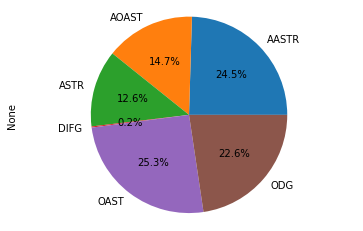

In [25]:
unified_meta.groupby("ONCOTREE_CODE").size().plot.pie(autopct='%1.1f%%')
plt.axis('equal')

Através da analise do gráfico, conclui-se que existem 3 tipos fundamentais de gliomas representados no dataset: Astrocitoma Anaplásico (AASTR), Oligodendroglioma (ODG) e Oligoastrocitoma (OAST).

<AxesSubplot:xlabel='CANCER_TYPE_DETAILED'>

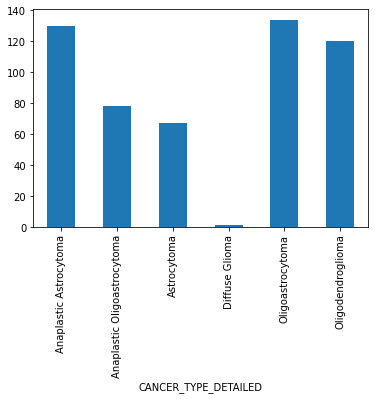

In [26]:
unified_meta.groupby("CANCER_TYPE_DETAILED").size().plot.bar()

Observa-se, também, que este atributo não é balanceado. 

Este poderia ser um _target_ interessante. Porém, conclui-se que por ser um atributo multiclasse, cuja previsão é mais complicada, assim como por não se encontrar balanceado, que seria adequado procurar um outro atributo que pudesse ter um melhor desempenho e com uma finalidade adequada.

Foi, então, analisado o atributo "GRADE", cuja finalidade seria igualmente importante na prestação de cuidados adequados aos portadores destes gliomas. Adicionalmente, observa-se que este, ao contrário do anterior, é um atributo balanceado e binomial.

<AxesSubplot:ylabel='None'>

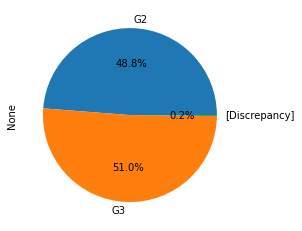

In [27]:
unified_meta.groupby("GRADE").size().plot.pie(autopct='%1.1f%%')

<AxesSubplot:xlabel='TUMOR_SITE'>

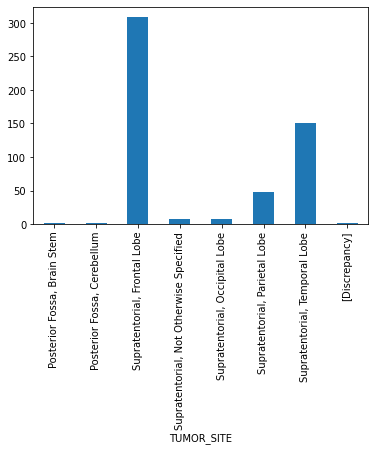

In [28]:
unified_meta.groupby("TUMOR_SITE").size().plot.bar()

<AxesSubplot:xlabel='SUPRATENTORIAL_LOCALIZATION'>

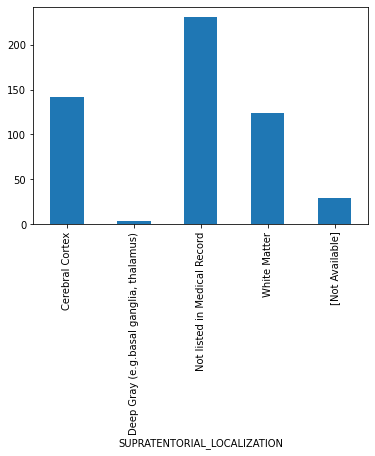

In [29]:
unified_meta.groupby("SUPRATENTORIAL_LOCALIZATION").size().plot.bar()

Tendo, por fim, analisado diversos atributos, conclui-se que o _target_ ideal seria o atributo "GRADE", relativo ao grau de agrssividade do glioma (G2 ou G3).

### Tratamento de Valores em Falta

Tendo escolhido o atributo _target_ e os atributos cuja presença poderá ou não ser útil ao processo de previsão, torna-se essencial efetuar a substituição dos valores em falta, de modo a poder compreender melhor quais os atributos a manter ou a remover. 

Subtituiram-se, assim, os valores em falta em atributos numéricos pela média dos valores presentes nos mesmos. No caso dos atributos categóricos, substituiram-se os valores em falta pela moda dos valores presentes nestes. No final, foi efetuada a confirmação da eficácia do processo de substituição, tendo-se garantido que não restavam valores deste tipo.

In [30]:
# Lista de colunas do tipo objeto que deveriam ser numéricas
object_columns_numeric = ['AGE','OS_MONTHS','DFS_MONTHS']

# Lista de colunas do tipo objeto que deveriam ser categóricas
object_columns_categorical = ['PATIENT_ID','OTHER_SAMPLE_ID','IS_FFPE','PATHOLOGY_REPORT_FILE_NAME','PATHOLOGY_REPORT_UUID',
                              'SAMPLE_TYPE','SAMPLE_TYPE_ID','VIAL_NUMBER', 'ONCOTREE_CODE', 'CANCER_TYPE', 'CANCER_TYPE_DETAILED','OTHER_PATIENT_ID',
                              'FORM_COMPLETION_DATE','HISTOLOGICAL_DIAGNOSIS','GRADE','LATERALITY','TUMOR_SITE','SUPRATENTORIAL_LOCALIZATION',
                              'PROSPECTIVE_COLLECTION','RETROSPECTIVE_COLLECTION','SEX','RACE','ETHNICITY','HISTORY_OTHER_MALIGNANCY',
                              'HISTORY_NEOADJUVANT_TRTYN','INITIAL_PATHOLOGIC_DX_YEAR','HISTORY_IONIZING_RT_TO_HEAD','SEIZURE_HISTORY','HEADACHE_HISTORY',
                              'SYMP_CHANGES_MENTAL_STATUS','SYMP_CHANGES_VISUAL','SYMP_CHANGES_SENSORY','SYMP_CHANGES_MOTOR_MOVEMENT',
                              'RELATED_SYMPTOM_FIRST_PRESENT','FIRST_SYMPTOM_LONGEST_DURATION','ASTHMA_HISTORY','ECZEMA_HISTORY','HAY_FEVER_HISTORY',
                              'HISTORY_NEOADJUVANT_STEROID_TX','HISTORY_NEOADJUVANT_MEDICATION','VITAL_STATUS','TUMOR_STATUS','FAMILY_HISTORY_OF_CANCER',
                              'FAMILY_HISTORY_OF_PRIMARY_BRAIN_TUMOR','IDH1_MUTATION_TEST_INDICATOR','DAYS_TO_INITIAL_PATHOLOGIC_DIAGNOSIS',
                              'ICD_10','ICD_O_3_HISTOLOGY','ICD_O_3_SITE','INFORMED_CONSENT_VERIFIED','TISSUE_SOURCE_SITE','SITE_OF_TUMOR_TISSUE',
                              'OS_STATUS','DFS_STATUS']

# Substituindo '[Not Available]' por NaN nas colunas
unified_meta.replace('[Not Available]', np.nan, inplace=True)
unified_meta.replace('[NOT AVAILABLE]', np.nan, inplace=True)
unified_meta.replace('Not listed in Medical Record', np.nan, inplace=True)


# Convertendo as colunas para tipo numérico
unified_meta[object_columns_numeric] = unified_meta[object_columns_numeric].apply(pd.to_numeric, errors='coerce')

# Substituindo NaN pela média em colunas convertidas para numérico
unified_meta[object_columns_numeric] = unified_meta[object_columns_numeric].apply(lambda col: col.fillna(col.mean()))

# Substituindo NaN pela moda em colunas categóricas
unified_meta[object_columns_categorical] = unified_meta[object_columns_categorical].apply(lambda col: col.fillna(col.mode()[0]))

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
mval=unified_meta.apply(lambda x: x[x == '[Not Available]'].count())/len(unified_meta)*100
mval.sort_values(ascending=False)    

DFS_MONTHS                               0.0
SEIZURE_HISTORY                          0.0
INITIAL_PATHOLOGIC_DX_YEAR               0.0
HISTORY_NEOADJUVANT_TRTYN                0.0
HISTORY_OTHER_MALIGNANCY                 0.0
ETHNICITY                                0.0
RACE                                     0.0
SEX                                      0.0
RETROSPECTIVE_COLLECTION                 0.0
PROSPECTIVE_COLLECTION                   0.0
SUPRATENTORIAL_LOCALIZATION              0.0
TUMOR_SITE                               0.0
LATERALITY                               0.0
GRADE                                    0.0
HISTOLOGICAL_DIAGNOSIS                   0.0
FORM_COMPLETION_DATE                     0.0
OTHER_PATIENT_ID                         0.0
CANCER_TYPE_DETAILED                     0.0
CANCER_TYPE                              0.0
ONCOTREE_CODE                            0.0
VIAL_NUMBER                              0.0
SAMPLE_TYPE_ID                           0.0
SAMPLE_TYP

In [31]:
unified_meta.isnull().sum()

PATIENT_ID                               0
OTHER_SAMPLE_ID                          0
IS_FFPE                                  0
PATHOLOGY_REPORT_FILE_NAME               0
PATHOLOGY_REPORT_UUID                    0
SAMPLE_TYPE                              0
SAMPLE_TYPE_ID                           0
VIAL_NUMBER                              0
ONCOTREE_CODE                            0
CANCER_TYPE                              0
CANCER_TYPE_DETAILED                     0
OTHER_PATIENT_ID                         0
FORM_COMPLETION_DATE                     0
HISTOLOGICAL_DIAGNOSIS                   0
GRADE                                    0
LATERALITY                               0
TUMOR_SITE                               0
SUPRATENTORIAL_LOCALIZATION              0
PROSPECTIVE_COLLECTION                   0
RETROSPECTIVE_COLLECTION                 0
SEX                                      0
RACE                                     0
ETHNICITY                                0
HISTORY_OTH

In [32]:
unified_meta.isna().sum()

PATIENT_ID                               0
OTHER_SAMPLE_ID                          0
IS_FFPE                                  0
PATHOLOGY_REPORT_FILE_NAME               0
PATHOLOGY_REPORT_UUID                    0
SAMPLE_TYPE                              0
SAMPLE_TYPE_ID                           0
VIAL_NUMBER                              0
ONCOTREE_CODE                            0
CANCER_TYPE                              0
CANCER_TYPE_DETAILED                     0
OTHER_PATIENT_ID                         0
FORM_COMPLETION_DATE                     0
HISTOLOGICAL_DIAGNOSIS                   0
GRADE                                    0
LATERALITY                               0
TUMOR_SITE                               0
SUPRATENTORIAL_LOCALIZATION              0
PROSPECTIVE_COLLECTION                   0
RETROSPECTIVE_COLLECTION                 0
SEX                                      0
RACE                                     0
ETHNICITY                                0
HISTORY_OTH

### Remoção de linhas

Voltando às representações gráficas efetuadas anteriormente, é relevante salientar que no atributo _target_, para além dos graus de agressividade dos gliomas, se encontra, também, um valor de discrepância. Esta discrepância representa uma caso, cujo diagnóstico foi inconclusivo, não sendo possivel reconhecer de que grau se tratava. Assim, concluiu-se que o melhor procedimento a seguir seria remover a única linha que continha este valor. Tal foi somente possível devido ao facto de este valor estar presente numa infima parte do dataset, sendo que a sua remoção não causa danos no dataset impossibilitando a obtenção de resultados realistas.

<AxesSubplot:ylabel='None'>

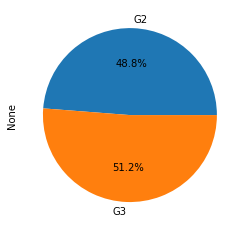

In [33]:
unified_meta = unified_meta[unified_meta['GRADE'] != '[Discrepancy]']
unified_meta.groupby("GRADE").size().plot.pie(autopct='%1.1f%%')

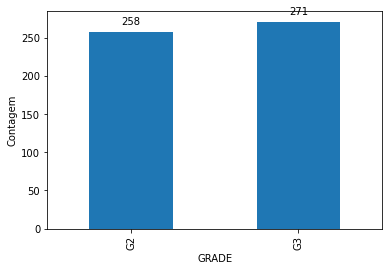

In [163]:
ax = unified_meta.groupby("GRADE").size().plot.bar()

# Adiciona os valores numéricos no topo de cada barra
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.xlabel('GRADE')
plt.ylabel('Contagem')

plt.show()

### Avaliação de correlações

De modo a conseguir determinar quais os atributos ideiais para manter para o processo de previsão, foi efetuada a avaliação das correlações entre cada atributo e o _target_. Este processo foi efetuado, inicialmente, recorrendo a matrizes de correlação e de contingência.

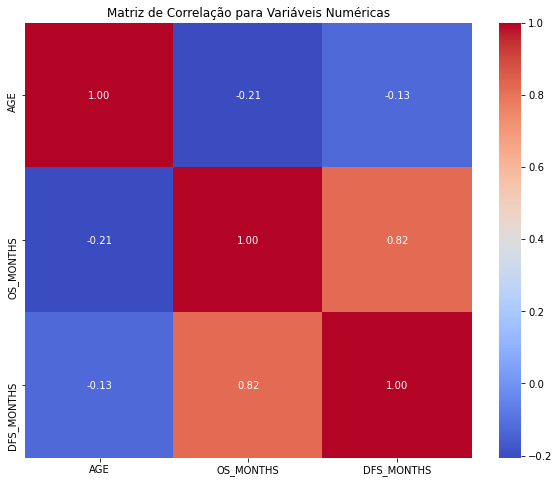


Matriz de Contingência para Variáveis Categóricas:
CANCER_TYPE_DETAILED  Anaplastic Astrocytoma  Anaplastic Oligoastrocytoma  \
VITAL_STATUS                                                                
Alive                                     80                           55   
Dead                                      50                           23   

CANCER_TYPE_DETAILED  Astrocytoma  Diffuse Glioma  Oligoastrocytoma  \
VITAL_STATUS                                                          
Alive                          58               1               106   
Dead                            9               0                27   

CANCER_TYPE_DETAILED  Oligodendroglioma  
VITAL_STATUS                             
Alive                                95  
Dead                                 25  


In [35]:
variaveis_numericas = unified_meta.select_dtypes(include='number')
variaveis_categoricas = unified_meta.select_dtypes(exclude='number')


matriz_correlacao_numericas = variaveis_numericas.corr()


matriz_contingencia_categoricas = pd.crosstab(variaveis_categoricas['VITAL_STATUS'], variaveis_categoricas['CANCER_TYPE_DETAILED'])


plt.figure(figsize=(10, 8))
sns.heatmap(matriz_correlacao_numericas, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlação para Variáveis Numéricas')
plt.show()

print("\nMatriz de Contingência para Variáveis Categóricas:")
print(matriz_contingencia_categoricas)

Após serem avaliados quais os melhores candidatos a atributos para utilização no processo de previsão, foram efetuadas representações gráficas da relação entre estes e o _target_. Assim, a análise destas relações torna-se mais visual e fácil de perceber.

Foram assim analisadas as relações entre o atributo _GRADE_ e os atributos _CANCER_TYPE_DETAILED_, _VITAL_STATUS_, _OS_MONTHS_ e _IDH1_MUTATION_TEST_INDICATOR_.

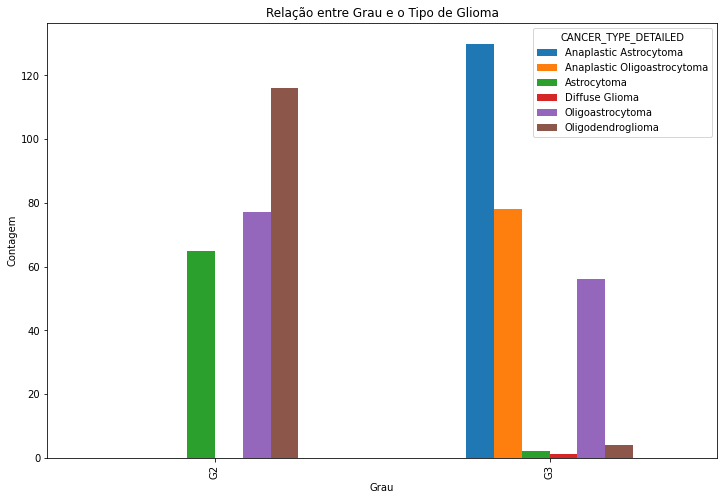

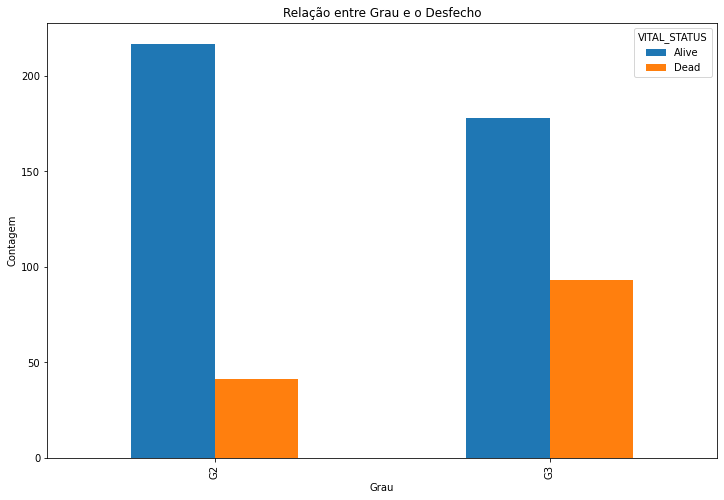

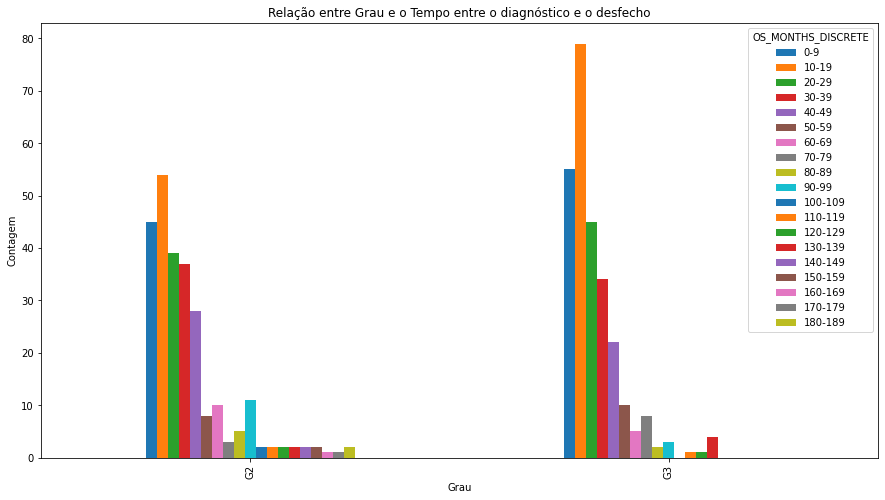

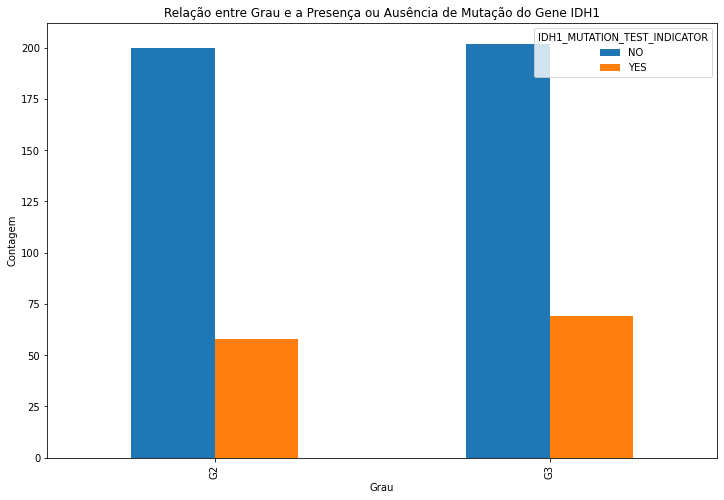

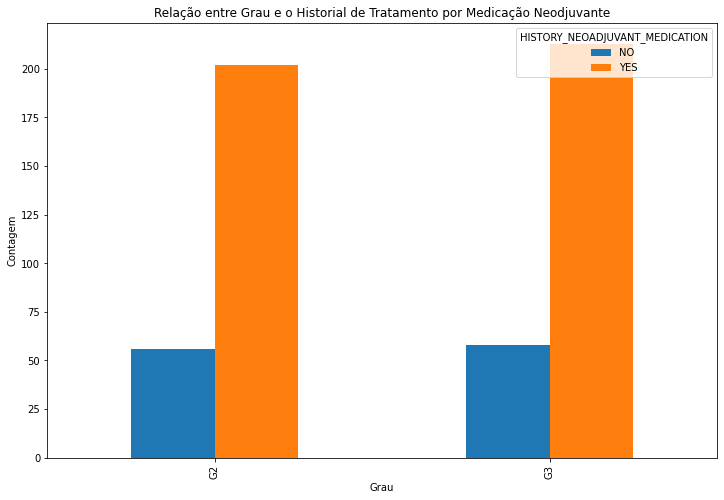

In [36]:
# Relação entre GRADE e CANCER_TYPE_DETAILED
matriz_contingencia_ct = pd.crosstab(unified_meta['GRADE'], unified_meta['CANCER_TYPE_DETAILED'])

cores = sns.color_palette()

matriz_contingencia_ct.plot(kind='bar', figsize=(12, 8), color=cores)
plt.title('Relação entre Grau e o Tipo de Glioma')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Relação entre GRADE e VITAL_STATUS
matriz_contingencia_vs = pd.crosstab(unified_meta['GRADE'], unified_meta['VITAL_STATUS'])

cores = sns.color_palette()

matriz_contingencia_vs.plot(kind='bar', figsize=(12, 8), color=cores)
plt.title('Relação entre Grau e o Desfecho')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Relação entre GRADE e OS_MONTHS
# Criar intervalos para a variável OS_MONTHS
bins = np.arange(0, 212, 10)  # Intervalos de 10 meses
labels = [f"{i}-{i+9}" for i in range(0, 210, 10)]  # Rótulos para os intervalos

relacao_osm_target=unified_meta.copy()
# Discretizar a variável numérica OS_MONTHS em intervalos
relacao_osm_target['OS_MONTHS_DISCRETE'] = pd.cut(unified_meta['OS_MONTHS'], bins=bins, labels=labels)


matriz_contingencia_osm = pd.crosstab(unified_meta['GRADE'], relacao_osm_target['OS_MONTHS_DISCRETE'])

cores = sns.color_palette()

matriz_contingencia_osm.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e o Tempo entre o diagnóstico e o desfecho')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Relação entre GRADE e IDH1_MUTATION_TEST_INDICATOR
matriz_contingencia_idh1 = pd.crosstab(unified_meta['GRADE'], unified_meta['IDH1_MUTATION_TEST_INDICATOR'])

cores = sns.color_palette()

matriz_contingencia_idh1.plot(kind='bar', figsize=(12, 8), color=cores)
plt.title('Relação entre Grau e a Presença ou Ausência de Mutação do Gene IDH1')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Relação entre GRADE e HISTORY_NEOADJUVANT_MEDICATION
matriz_contingencia_hnm = pd.crosstab(unified_meta['GRADE'], unified_meta['HISTORY_NEOADJUVANT_MEDICATION'])

cores = sns.color_palette()

matriz_contingencia_hnm.plot(kind='bar', figsize=(12, 8), color=cores)
plt.title('Relação entre Grau e o Historial de Tratamento por Medicação Neodjuvante')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()


Através dos gráficos apresentados, pode-se destacar a relação entre o _target_ e o tipo de glioma, sendo, por exemplo, astrocitomas anaplásicos mais frequentes em patologias de G3, enquanto que em G2 é mais prevalente a existência de Oligodendrogliomas. 

Adicionalmente, é encontrada uma relação forte entre o grau da doença e o tempo entre o diagnóstico e o desfecho. Verifica-se um prolongamento maior no tempo para gliomas de grau inferior, uma tendência compreensível dada a menor agressividade do tumor.

Relativamente ao estado vital dos indivíduos, verifica-se uma taxa de mortalidade superior para G3. Tal facto justifica-se, mais uma vez, pela agressividade do glioma. Porém, a diferença deste atributo para os diferentes graus em estudo não é considerada muito significativa, pelo que este poderá ou não ser um bom candidato a utilização no processo de previsão.

Quanto à presença ou ausência de mutação no gene IDH1, ao contrário daquilo que era esperado segundo a literatura, observa-se uma fraca correlação com o atributo que se pretende prever, sendo que este foi descartado posteriormente.

Por fim, em relação à administração anterior de medicação neoadjuvante, observa-se um maior impacto para gliomas de G3, porém, à semelhança do que acontece com o atributo _VITAL_STATUS_, considera-se que poderá ou não ser um bom candidato ao processo de previsão.

Deste modo, foram selecionados os atributos _CANCER_TYPE_DETAILED_,_GRADE_, _OS_MONTHS_, _HISTORY_NEOADJUVANT_MEDICATION_ e _VITAL_STATUS_.

### Seleção de Atributos (amostras e pacientes)

In [37]:
selected_columns = ["CANCER_TYPE_DETAILED","GRADE", "OS_MONTHS", "HISTORY_NEOADJUVANT_MEDICATION", "VITAL_STATUS"]
subset_meta = unified_meta[selected_columns]
subset_meta.head()

,CANCER_TYPE_DETAILED,GRADE,OS_MONTHS,HISTORY_NEOADJUVANT_MEDICATION,VITAL_STATUS
Sample Identifier,,,,,
TCGA-CS-6290-01,Anaplastic Astrocytoma,G3,37.35,NO,Dead
TCGA-DU-5847-01,Anaplastic Astrocytoma,G3,18.00,YES,Alive
TCGA-DU-5849-01,Oligodendroglioma,G2,14.55,YES,Alive
TCGA-DU-5852-01,Oligoastrocytoma,G3,6.73,YES,Dead
TCGA-DU-5854-01,Anaplastic Astrocytoma,G3,8.44,YES,Alive


### Análise e Tratamento do Dataset _data_glioma_

In [38]:
data_glioma.head()

,TCGA-CS-4938-01,TCGA-CS-4941-01,TCGA-CS-4942-01,TCGA-CS-4943-01,TCGA-CS-4944-01,TCGA-CS-5390-01,TCGA-CS-5393-01,TCGA-CS-5394-01,TCGA-CS-5395-01,TCGA-CS-5396-01,TCGA-CS-5397-01,TCGA-CS-6186-01,TCGA-CS-6188-01,TCGA-CS-6290-01,TCGA-CS-6665-01,TCGA-CS-6666-01,TCGA-CS-6667-01,TCGA-CS-6668-01,TCGA-CS-6669-01,TCGA-CS-6670-01,TCGA-DB-5270-01,TCGA-DB-5273-01,TCGA-DB-5274-01,TCGA-DB-5275-01,TCGA-DB-5276-01,TCGA-DB-5277-01,TCGA-DB-5278-01,TCGA-DB-5279-01,TCGA-DB-5280-01,TCGA-DB-5281-01,TCGA-DB-A4X9-01,TCGA-DB-A4XA-01,TCGA-DB-A4XB-01,TCGA-DB-A4XC-01,TCGA-DB-A4XD-01,TCGA-DB-A4XE-01,TCGA-DB-A4XF-01,TCGA-DB-A4XG-01,TCGA-DB-A4XH-01,TCGA-DB-A64L-01,TCGA-DB-A64O-01,TCGA-DB-A64P-01,TCGA-DB-A64Q-01,TCGA-DB-A64R-01,TCGA-DB-A64S-01,TCGA-DB-A64U-01,TCGA-DB-A64V-01,TCGA-DB-A64W-01,TCGA-DB-A64X-01,TCGA-DB-A75K-01,TCGA-DB-A75L-01,TCGA-DB-A75M-01,TCGA-DB-A75O-01,TCGA-DB-A75P-01,TCGA-DH-5140-01,TCGA-DH-5141-01,TCGA-DH-5142-01,TCGA-DH-5143-01,TCGA-DH-5144-01,TCGA-DH-A669-01,TCGA-DH-A669-02,TCGA-DH-A66B-01,TCGA-DH-A66D-01,TCGA-DH-A66F-01,TCGA-DH-A66G-01,TCGA-DH-A7UR-01,TCGA-DH-A7US-01,TCGA-DH-A7UT-01,TCGA-DH-A7UU-01,TCGA-DH-A7UV-01,TCGA-DU-5847-01,TCGA-DU-5849-01,TCGA-DU-5851-01,TCGA-DU-5852-01,TCGA-DU-5853-01,TCGA-DU-5854-01,TCGA-DU-5855-01,TCGA-DU-5870-01,TCGA-DU-5870-02,TCGA-DU-5871-01,TCGA-DU-5872-01,TCGA-DU-5872-02,TCGA-DU-5874-01,TCGA-DU-6392-01,TCGA-DU-6393-01,TCGA-DU-6394-01,TCGA-DU-6395-01,TCGA-DU-6396-01,TCGA-DU-6397-01,TCGA-DU-6397-02,TCGA-DU-6399-01,TCGA-DU-6400-01,TCGA-DU-6401-01,TCGA-DU-6402-01,TCGA-DU-6403-01,TCGA-DU-6404-01,TCGA-DU-6404-02,TCGA-DU-6405-01,TCGA-DU-6406-01,TCGA-DU-6407-01,TCGA-DU-6407-02,TCGA-DU-6408-01,TCGA-DU-6410-01,TCGA-DU-6542-01,TCGA-DU-7006-01,TCGA-DU-7007-01,TCGA-DU-7008-01,TCGA-DU-7009-01,TCGA-DU-7010-01,TCGA-DU-7011-01,TCGA-DU-7012-01,TCGA-DU-7013-01,TCGA-DU-7014-01,TCGA-DU-7015-01,TCGA-DU-7018-01,TCGA-DU-7019-01,TCGA-DU-7290-01,TCGA-DU-7292-01,TCGA-DU-7294-01,TCGA-DU-7298-01,TCGA-DU-7299-01,TCGA-DU-7300-01,TCGA-DU-7301-01,TCGA-DU-7302-01,TCGA-DU-7304-01,TCGA-DU-7304-02,TCGA-DU-7306-01,TCGA-DU-7309-01,TCGA-DU-8158-01,TCGA-DU-8161-01,TCGA-DU-8162-01,TCGA-DU-8163-01,TCGA-DU-8164-01,TCGA-DU-8165-01,TCGA-DU-8166-01,TCGA-DU-8167-01,TCGA-DU-8168-01,TCGA-DU-A5TP-01,TCGA-DU-A5TR-01,TCGA-DU-A5TS-01,TCGA-DU-A5TT-01,TCGA-DU-A5TU-01,TCGA-DU-A5TW-01,TCGA-DU-A5TY-01,TCGA-DU-A6S2-01,TCGA-DU-A6S3-01,TCGA-DU-A6S6-01,TCGA-DU-A6S7-01,TCGA-DU-A6S8-01,TCGA-DU-A76K-01,TCGA-DU-A76L-01,TCGA-DU-A76O-01,TCGA-DU-A76R-01,TCGA-DU-A7T6-01,TCGA-DU-A7T8-01,TCGA-DU-A7TA-01,TCGA-DU-A7TB-01,TCGA-DU-A7TC-01,TCGA-DU-A7TD-01,TCGA-DU-A7TG-01,TCGA-DU-A7TI-01,TCGA-DU-A7TJ-01,TCGA-E1-5302-01,TCGA-E1-5303-01,TCGA-E1-5304-01,TCGA-E1-5305-01,TCGA-E1-5307-01,TCGA-E1-5311-01,TCGA-E1-5318-01,TCGA-E1-5319-01,TCGA-E1-5322-01,TCGA-E1-A7YD-01,TCGA-E1-A7YE-01,TCGA-E1-A7YH-01,TCGA-E1-A7YI-01,TCGA-E1-A7YJ-01,TCGA-E1-A7YK-01,TCGA-E1-A7YL-01,TCGA-E1-A7YM-01,TCGA-E1-A7YN-01,TCGA-E1-A7YO-01,TCGA-E1-A7YQ-01,TCGA-E1-A7YS-01,TCGA-E1-A7YU-01,TCGA-E1-A7YV-01,TCGA-E1-A7YW-01,TCGA-E1-A7YY-01,TCGA-E1-A7Z2-01,TCGA-E1-A7Z3-01,TCGA-E1-A7Z4-01,TCGA-E1-A7Z6-01,TCGA-EZ-7264-01,TCGA-F6-A8O3-01,TCGA-F6-A8O4-01,TCGA-FG-5962-01,TCGA-FG-5963-01,TCGA-FG-5963-02,TCGA-FG-5964-01,TCGA-FG-5965-01,TCGA-FG-5965-02,TCGA-FG-6688-01,TCGA-FG-6689-01,TCGA-FG-6690-01,TCGA-FG-6691-01,TCGA-FG-6692-01,TCGA-FG-7634-01,TCGA-FG-7636-01,TCGA-FG-7637-01,TCGA-FG-7638-01,TCGA-FG-7641-01,TCGA-FG-7643-01,TCGA-FG-8181-01,TCGA-FG-8182-01,TCGA-FG-8185-01,TCGA-FG-8186-01,TCGA-FG-8187-01,TCGA-FG-8188-01,TCGA-FG-8189-01,TCGA-FG-8191-01,TCGA-FG-A4MT-01,TCGA-FG-A4MT-02,TCGA-FG-A4MU-01,TCGA-FG-A4MW-01,TCGA-FG-A4MX-01,TCGA-FG-A4MY-01,TCGA-FG-A60J-01,TCGA-FG-A60K-01,TCGA-FG-A60L-01,TCGA-FG-A6IZ-01,TCGA-FG-A6J1-01,TCGA-FG-A6J3-01,TCGA-FG-A70Y-01,TCGA-FG-A70Z-01,TCGA-FG-A710-01,TCGA-FG-A711-01,TCGA-FG-A713-01,TCGA-FG-A87N-01,TCGA-FG-A87Q-01,TCGA-FN-7833-01,TCGA-HT-7467-01,TCGA-HT-7468-01,TCGA-HT-7469-01,TCGA-HT-7470-01,TCGA-HT-7471-01,TCGA-HT-7472-01,TCGA-HT-7473-01,TCGA-HT-7474-01,TCGA-HT-7475-01,TCGA-HT-7476-01,TCGA-HT-7477-01

O primeiro passo na análise deste dataset residia na verificação da existência ou ausência de valores em falta.

In [39]:
data_glioma.isnull().sum()

TCGA-CS-4938-01    0
TCGA-CS-4941-01    0
TCGA-CS-4942-01    0
TCGA-CS-4943-01    0
TCGA-CS-4944-01    0
TCGA-CS-5390-01    0
TCGA-CS-5393-01    0
TCGA-CS-5394-01    0
TCGA-CS-5395-01    0
TCGA-CS-5396-01    0
TCGA-CS-5397-01    0
TCGA-CS-6186-01    0
TCGA-CS-6188-01    0
TCGA-CS-6290-01    0
TCGA-CS-6665-01    0
TCGA-CS-6666-01    0
TCGA-CS-6667-01    0
TCGA-CS-6668-01    0
TCGA-CS-6669-01    0
TCGA-CS-6670-01    0
TCGA-DB-5270-01    0
TCGA-DB-5273-01    0
TCGA-DB-5274-01    0
TCGA-DB-5275-01    0
TCGA-DB-5276-01    0
TCGA-DB-5277-01    0
TCGA-DB-5278-01    0
TCGA-DB-5279-01    0
TCGA-DB-5280-01    0
TCGA-DB-5281-01    0
TCGA-DB-A4X9-01    0
TCGA-DB-A4XA-01    0
TCGA-DB-A4XB-01    0
TCGA-DB-A4XC-01    0
TCGA-DB-A4XD-01    0
TCGA-DB-A4XE-01    0
TCGA-DB-A4XF-01    0
TCGA-DB-A4XG-01    0
TCGA-DB-A4XH-01    0
TCGA-DB-A64L-01    0
TCGA-DB-A64O-01    0
TCGA-DB-A64P-01    0
TCGA-DB-A64Q-01    0
TCGA-DB-A64R-01    0
TCGA-DB-A64S-01    0
TCGA-DB-A64U-01    0
TCGA-DB-A64V-01    0
TCGA-DB-A64W-

Após verificar que o conjunto de dados não continha valores ausentes, procedeu-se com a transposição deste. Essa transposição foi realizada para que os genes fossem tratados como atributos e as amostras como linhas, possibilitando a análise do impacto desses genes na variável alvo (_target_).

In [40]:
data_glioma=data_glioma.transpose()
data_glioma.head()

Hugo_Symbol,LOC100130426,UBE2Q2P3,UBE2Q2P3,LOC149767,TIMM23,MOXD2,LOC155060,RNU12-2P,SSX9,LOC317712,CXORF67,EFCAB8,SRP14P1,LOC391343,TRIM75P,SPATA31B1P,LOC286106,SDR16C6P,LOC553137,KIAA1618,LOC645851,RGPD7,HSPB1P1,PPBPL1,LOC594835,ANKRD20A20P,TMPRSS11E2,LOC100132347,EFCAB12,LOC147680,A1CF,RBFOX1,GGACT,A2ML1,A2M,P1,A4GNT,NPSR1-AS1,AAAS,LOC391856,AACS,AADACL2,LOC649285,AADACL4,AADAC,AADAT,AAGAB,DKFZp686K16132,AAMP,AANAT,LOC221410,AARSD1,AARS,AASDHPPT,AASDH,AASS,AATF,LOC100292717,NPD009,PRO2543,ABCA11P,ICR5,ABCA13,ABCA17P,TGD,ABCA2,ABCA3,STGD1,HSA275973,ABCA6,ABCA7,ABCA8,ABCA9,ABCB10,PFIC2,ABCB1,ABCB4,ABCB5,ABCB6,ABCB7,ABCB8,ABCB9,ABCC10,EWWD,ABCC12,ABCC13,ABCC1,ABCC2,ABCC3,ABCC4,ABCC5,ABCC6P1,ABCC6P2,PXE,ABCC8,ABCC9,ABCD1,ABCD2,ABCD3,ABCD4,ABCE1,ABCF1,ABCF2,ABCF3,ABCG1,ABCG2,ABCG4,ABCG5,LOC115232,ABHD10,ABHD11,ABHD12B,C20orf22,ABHD13,ABHD14A,ABHD14B,ABHD15,ABHD1,LOC654057,ABHD3,ABHD4,ABHD5,ABHD6,ABHD8,ABI1,ABI2,FLJ21551,ABI3,LOC116063,ABL2,ABLIM1,ABLIM2,ABLIM3,ABO,AOC1,ABRA,ABR,ABT1,ABTB1,ABTB2,ACAA1,LOC147548,ACACA,ACACB,ACAD10,ACAD11,ACAD8,ACAD9,ACADL,ACADM,LOC654185,ACADS,ACADVL,ACAN,ACAP1,ACAP2,ACAP3,ACAT1,ACAT2,ACBD3,ACBD4,ACBD5,ACBD6,ACBD7,LOC654199,ASIC1,ASIC3,ASIC4,ASIC5,ACCSL,ACCS,ACD,DKFZP434A014,ASAH3,ACER2,ACER3,LOC654142,ACEE,ACIN1,ACLY,ACMSD,SDHAF3,IREB1,LOC115645,ACOT11,ACOT12,ACOT13,LOC145480,ACOT2,ACOT4,ACOT6,ACOT7,ACOT8,ACOT9,ACOX1,ACOX2,ACOX3,ACOXL,ACP1,LOC96117,ACP5,LOC116107,PXYLP1,ACPP,ACPT,ACRBP,NAAR1,ACRV1,ACR,ACSBG1,ACSBG2,ACSF2,ACSF3,FACL1,PRO2194,MRX63,ACSL5,ACSL6,ACSM1,ACSM2A,ACSM2B,ACSM3,ACSM4,ACSM5,LOC89850,ACSS2,ACSS3,LOC115745,ACTA2,ACTBL2,LOC115571,ACTC1,DFNA26,LOC115664,ACTL6A,ACTL6B,ACTL7A,ACTL7B,ACTL8,ACTL9,ACTN1,ACTN2,ACTN3,FSGS1,ACTR10,ACTR1A,LOC130640,ACTR2,ACTR3B,LOC155033,ACTR3,ACTR5,ACTR6,ACTR8,ACTRT1,ACTRT2,ACVR1B,ACVR1C,FOP,ACVR2A,ACVR2B,ACVRL1,ACY1,ACY3,ACYP1,LOC115706,ADAD1,ADAD2,ADAL,ADAM10,ADAM11,CAR10,ADAM15,LOC129645,ADAM18,ADAM19,ADAM20,ADAM21P1,ADAM21,MDC2,ADAM23,EMDCII,ADAM29,ADAM2,ADAM30,ADAM32,DJ964F7.1,ADAM3A,ADAM5,ADAM6,ADAM7,ADAM8,ADAM9,ADAMDEC1,WMS,ADAMTS12,DKFZp434C2322,ADAMTS14,ADAMTS15,ADAMTS16,ADAMTS17,ADAMTS18,ADAMTS19,ADAMTS1,ADAMTS20,ADAMTS2,KIAA0366,ADAMTS4,ADAMTS5,LOC345667,DKFZP434H204,ADAMTS8,ADAMTS9,ADAMTSL1,ADAMTSL2,ADAMTSL3,LOC105371437,ADAMTSL5,ADAP1,ADAP2,ADARB1,LOC100130729,IFI4,ADAT1,ADAT2,ADAT3,ADA,ADCK1,ADCK2,ADCK4,ADCK5,ADCY10,DFNB44,ADCY2,AC3,ADCY4,ADCY5,ADCY6,ADCY7,ADCY8,ADCY9,ADCYAP1R1,ADCYAP1,AZIN2,ADD1,LOC130935,ADD3,ADH1A,ADH1B,ADH1C,ADH4,FDH,ADH6,ADH7,ADHFE1,ADI1,ADIG,APM-1,ADIPOR1,ADIPOR2,ADK,ADM2,ADM,ADNP2,LOC256440,ADORA1,ADORA2A,ADORA2B,ADORA3,ADO,ADPGK,ADPRHL1,ADPRHL2,ADPRH,ADRA1A,ADRA1B,ADRA1D,LOC92480,ADRA2B,ADRA2C,ADRB1,ADRB2,LOC157462,ADRBK1,ADRBK2,ADRM1,ADSL,ADSSL1,ADSS,AEBP1,AEBP2,AEN,AES,AFAP1L1,AFAP1L2,AFAP1,AKR7A2P1,PBM1,AFF2,AFF3,AFF4,FLJ45200,SCA28,AFMID,AFM,AFP,AFTPH,C11ORF96,AGAP11,AGAP1,KIAA0167,LOC100134082,AGAP4,LOC118704,AGAP6,AGAP7P,AGAP8,AGA,LOC728206,AGBL2,FLJ12983,AGBL4,AGBL5,AGER,AGFG1,RAB-R,HSU84971,AGK,AGL,LOC100507192,MGC5423,AGPAT2,AGPAT3,AGPAT4,AGPAT5,AGPAT6,AGPAT9,HYKK,AGPS,AGR2,AGR3,LOC348522,AGRP,AGTPBP1,AGTR1B,AGTR2,AGTRAP,AGT,ETNPPL,PHYKPL,AGXT2,AGXT,AHCTF1,LOC115541,AHCYL2,AHCY,AHDC1,AHI1,AHNAK2,AHNAKRS,LOC256948,AHR,AHSA1,AHSA2,AHSG,AHSP,AICDA,LOC92615,AIF1L,LOC116399,NAMSD,MGC13000,AIFM3,LOC51638,FLJ38020,ST4,AIM2,AIMP1,AIMP2,AIPL1,AIP,AIRE,AJAP1,AK1,AK2,AK4,AK3,AK5,AK7,AKAP10,AKAP11,GRAVIN,LBC,AKAP14,PRKA1,PRKA2,AKAP3,AKAP4,AKAP5,AKAP6,LOC51743,AKAP8L,AKAP8,AKAP450,AK9,AKIRIN1,AKIRIN2,AKNAD1,LOC158267,AKR1A1,AKR1B11,AKR1B15,AKR1B1,AKR1C1,TDD,HSD17B5,AKR1C4,AKR1C8P,AKR1D1,AKR1E2,LOC115578,AKR7A3,AKR7L,AKT1S1,AKT1,AKT2,AKT3,AKTIP,ALAD,ALAS1,LOC115365,ALB,ALCAM,ALDH16A1,LOC118736,ALDH1A1,ALDH1A2,LOC145757,ALDH1B1,ALDH1L1,ALDH1L2,ALDH2,ALDH3A1,ALDH3A2,LOC115175,ALDH3B2,ALDH4A1,ALDH5A1,LOC100506517,EPD,ALDH8A1,ALDH9A1,LOC115339,LOC138369,ALDOC,ALG10B,ALG10,ALG11,ALG12,LOC728848,LOC116072,ALG1L2,ALG1L,ALG1,ALG2,LOC131416,ALG5,LOC94752,ALG8,ALG9,ALKBH1,ALKBH2,LOC143968,ALKBH4,ALKBH5,ALKBH6,ALKBH7,ALKBH8,ALK,AL

Em seguida, visto que não é conhecida a distribuição dos dados e garantir uma distribuição normal, cuja média é próxima de 0 e o desvio padrão de 1, foi efetuada a padronização dos dados. 

A distribuição normal dos dados é importante, pois determinados algorítmos são sensíveis à escala (SVM ou KNN, por exemplo).

In [41]:
data_glioma = pd.DataFrame(data_glioma)

# Extrair os nomes das linhas (índices) do dataset original
index_names = data_glioma.index.tolist()

column_names = data_glioma.columns.tolist()

# Aplicar a transformação com StandardScaler
scaler = StandardScaler()
data_glioma_transformed = scaler.fit_transform(data_glioma)

data_glioma = pd.DataFrame(data_glioma_transformed, index=index_names, columns=column_names)

data_glioma.head()

,LOC100130426,UBE2Q2P3,UBE2Q2P3,LOC149767,TIMM23,MOXD2,LOC155060,RNU12-2P,SSX9,LOC317712,CXORF67,EFCAB8,SRP14P1,LOC391343,TRIM75P,SPATA31B1P,LOC286106,SDR16C6P,LOC553137,KIAA1618,LOC645851,RGPD7,HSPB1P1,PPBPL1,LOC594835,ANKRD20A20P,TMPRSS11E2,LOC100132347,EFCAB12,LOC147680,A1CF,RBFOX1,GGACT,A2ML1,A2M,P1,A4GNT,NPSR1-AS1,AAAS,LOC391856,AACS,AADACL2,LOC649285,AADACL4,AADAC,AADAT,AAGAB,DKFZp686K16132,AAMP,AANAT,LOC221410,AARSD1,AARS,AASDHPPT,AASDH,AASS,AATF,LOC100292717,NPD009,PRO2543,ABCA11P,ICR5,ABCA13,ABCA17P,TGD,ABCA2,ABCA3,STGD1,HSA275973,ABCA6,ABCA7,ABCA8,ABCA9,ABCB10,PFIC2,ABCB1,ABCB4,ABCB5,ABCB6,ABCB7,ABCB8,ABCB9,ABCC10,EWWD,ABCC12,ABCC13,ABCC1,ABCC2,ABCC3,ABCC4,ABCC5,ABCC6P1,ABCC6P2,PXE,ABCC8,ABCC9,ABCD1,ABCD2,ABCD3,ABCD4,ABCE1,ABCF1,ABCF2,ABCF3,ABCG1,ABCG2,ABCG4,ABCG5,LOC115232,ABHD10,ABHD11,ABHD12B,C20orf22,ABHD13,ABHD14A,ABHD14B,ABHD15,ABHD1,LOC654057,ABHD3,ABHD4,ABHD5,ABHD6,ABHD8,ABI1,ABI2,FLJ21551,ABI3,LOC116063,ABL2,ABLIM1,ABLIM2,ABLIM3,ABO,AOC1,ABRA,ABR,ABT1,ABTB1,ABTB2,ACAA1,LOC147548,ACACA,ACACB,ACAD10,ACAD11,ACAD8,ACAD9,ACADL,ACADM,LOC654185,ACADS,ACADVL,ACAN,ACAP1,ACAP2,ACAP3,ACAT1,ACAT2,ACBD3,ACBD4,ACBD5,ACBD6,ACBD7,LOC654199,ASIC1,ASIC3,ASIC4,ASIC5,ACCSL,ACCS,ACD,DKFZP434A014,ASAH3,ACER2,ACER3,LOC654142,ACEE,ACIN1,ACLY,ACMSD,SDHAF3,IREB1,LOC115645,ACOT11,ACOT12,ACOT13,LOC145480,ACOT2,ACOT4,ACOT6,ACOT7,ACOT8,ACOT9,ACOX1,ACOX2,ACOX3,ACOXL,ACP1,LOC96117,ACP5,LOC116107,PXYLP1,ACPP,ACPT,ACRBP,NAAR1,ACRV1,ACR,ACSBG1,ACSBG2,ACSF2,ACSF3,FACL1,PRO2194,MRX63,ACSL5,ACSL6,ACSM1,ACSM2A,ACSM2B,ACSM3,ACSM4,ACSM5,LOC89850,ACSS2,ACSS3,LOC115745,ACTA2,ACTBL2,LOC115571,ACTC1,DFNA26,LOC115664,ACTL6A,ACTL6B,ACTL7A,ACTL7B,ACTL8,ACTL9,ACTN1,ACTN2,ACTN3,FSGS1,ACTR10,ACTR1A,LOC130640,ACTR2,ACTR3B,LOC155033,ACTR3,ACTR5,ACTR6,ACTR8,ACTRT1,ACTRT2,ACVR1B,ACVR1C,FOP,ACVR2A,ACVR2B,ACVRL1,ACY1,ACY3,ACYP1,LOC115706,ADAD1,ADAD2,ADAL,ADAM10,ADAM11,CAR10,ADAM15,LOC129645,ADAM18,ADAM19,ADAM20,ADAM21P1,ADAM21,MDC2,ADAM23,EMDCII,ADAM29,ADAM2,ADAM30,ADAM32,DJ964F7.1,ADAM3A,ADAM5,ADAM6,ADAM7,ADAM8,ADAM9,ADAMDEC1,WMS,ADAMTS12,DKFZp434C2322,ADAMTS14,ADAMTS15,ADAMTS16,ADAMTS17,ADAMTS18,ADAMTS19,ADAMTS1,ADAMTS20,ADAMTS2,KIAA0366,ADAMTS4,ADAMTS5,LOC345667,DKFZP434H204,ADAMTS8,ADAMTS9,ADAMTSL1,ADAMTSL2,ADAMTSL3,LOC105371437,ADAMTSL5,ADAP1,ADAP2,ADARB1,LOC100130729,IFI4,ADAT1,ADAT2,ADAT3,ADA,ADCK1,ADCK2,ADCK4,ADCK5,ADCY10,DFNB44,ADCY2,AC3,ADCY4,ADCY5,ADCY6,ADCY7,ADCY8,ADCY9,ADCYAP1R1,ADCYAP1,AZIN2,ADD1,LOC130935,ADD3,ADH1A,ADH1B,ADH1C,ADH4,FDH,ADH6,ADH7,ADHFE1,ADI1,ADIG,APM-1,ADIPOR1,ADIPOR2,ADK,ADM2,ADM,ADNP2,LOC256440,ADORA1,ADORA2A,ADORA2B,ADORA3,ADO,ADPGK,ADPRHL1,ADPRHL2,ADPRH,ADRA1A,ADRA1B,ADRA1D,LOC92480,ADRA2B,ADRA2C,ADRB1,ADRB2,LOC157462,ADRBK1,ADRBK2,ADRM1,ADSL,ADSSL1,ADSS,AEBP1,AEBP2,AEN,AES,AFAP1L1,AFAP1L2,AFAP1,AKR7A2P1,PBM1,AFF2,AFF3,AFF4,FLJ45200,SCA28,AFMID,AFM,AFP,AFTPH,C11ORF96,AGAP11,AGAP1,KIAA0167,LOC100134082,AGAP4,LOC118704,AGAP6,AGAP7P,AGAP8,AGA,LOC728206,AGBL2,FLJ12983,AGBL4,AGBL5,AGER,AGFG1,RAB-R,HSU84971,AGK,AGL,LOC100507192,MGC5423,AGPAT2,AGPAT3,AGPAT4,AGPAT5,AGPAT6,AGPAT9,HYKK,AGPS,AGR2,AGR3,LOC348522,AGRP,AGTPBP1,AGTR1B,AGTR2,AGTRAP,AGT,ETNPPL,PHYKPL,AGXT2,AGXT,AHCTF1,LOC115541,AHCYL2,AHCY,AHDC1,AHI1,AHNAK2,AHNAKRS,LOC256948,AHR,AHSA1,AHSA2,AHSG,AHSP,AICDA,LOC92615,AIF1L,LOC116399,NAMSD,MGC13000,AIFM3,LOC51638,FLJ38020,ST4,AIM2,AIMP1,AIMP2,AIPL1,AIP,AIRE,AJAP1,AK1,AK2,AK4,AK3,AK5,AK7,AKAP10,AKAP11,GRAVIN,LBC,AKAP14,PRKA1,PRKA2,AKAP3,AKAP4,AKAP5,AKAP6,LOC51743,AKAP8L,AKAP8,AKAP450,AK9,AKIRIN1,AKIRIN2,AKNAD1,LOC158267,AKR1A1,AKR1B11,AKR1B15,AKR1B1,AKR1C1,TDD,HSD17B5,AKR1C4,AKR1C8P,AKR1D1,AKR1E2,LOC115578,AKR7A3,AKR7L,AKT1S1,AKT1,AKT2,AKT3,AKTIP,ALAD,ALAS1,LOC115365,ALB,ALCAM,ALDH16A1,LOC118736,ALDH1A1,ALDH1A2,LOC145757,ALDH1B1,ALDH1L1,ALDH1L2,ALDH2,ALDH3A1,ALDH3A2,LOC115175,ALDH3B2,ALDH4A1,ALDH5A1,LOC100506517,EPD,ALDH8A1,ALDH9A1,LOC115339,LOC138369,ALDOC,ALG10B,ALG10,ALG11,ALG12,LOC728848,LOC116072,ALG1L2,ALG1L,ALG1,ALG2,LOC131416,ALG5,LOC94752,ALG8,ALG9,ALKBH1,ALKBH2,LOC143968,ALKBH4,ALKBH5,ALKBH6,ALKBH7,ALKBH8,ALK,ALLC,ALMS1P,K

## Secção 2

### Aprendizagem não supervisionada

A aprendizagem não supervisionada é uma abordagem na qual o algoritmo é treinado em dados que não têm rótulos ou categorias previamente definidas. O objetivo principal da aprendizagem não supervisionada é explorar a estrutura intrínseca ou padrões subjacentes nos dados, sem a orientação de rótulos de saída.

Assim, seria necessário definir inicialmente quais os genes com maior variância, sendo estes os que apresentam maior grau de mutação.

Após se obter a lista de genes com maior taxa de mutação, seriam definidos 2 _clusters_, correspondentes a cada tipo da grau, sem o fornecimento dos dados específicos do grau de agressividade do glioma, de modo a procurar entender se os genes selecionados permitem uma distinção clara de cada grau.

De modo a ser claro se o processo de seleção de genes tem um impacto positivo no modelo, foi analisado numa primeira instância o PCA dos dados genéticos completos.

In [102]:
n_components = 0.95
pca = PCA(n_components)
X_r = pca.fit_transform(data_glioma)
print(X_r.shape[1])

343


Explained Variance: [0.09820889 0.08337117 0.07853298 0.04577847 0.03381319 0.02821899
 0.02468207 0.01954256 0.01786624 0.01730621 0.01417395 0.01319373
 0.01024939 0.01007851 0.00910117 0.00862489 0.00781989 0.00760049
 0.0069229  0.00651613 0.00636421 0.00591462 0.00586989 0.00550906
 0.00533685 0.0050477  0.00457406 0.00449601 0.00435603 0.00421229
 0.00417404 0.00402551 0.0039159  0.00387418 0.00377136 0.00369383
 0.00360609 0.00356572 0.00348201 0.00346697 0.00341457 0.00333518
 0.00332128 0.0032798  0.00319271 0.00312147 0.00306295 0.00300731
 0.00293272 0.00290604 0.00285293 0.00279247 0.00275784 0.00273304
 0.00272274 0.0026979  0.00259258 0.00255221 0.00250238 0.00247083
 0.00240041 0.00235183 0.00234201 0.00229324 0.00227531 0.00225946
 0.00225071 0.00223408 0.00221142 0.00213458 0.00212523 0.00209178
 0.00207581 0.00205961 0.00202902 0.00201593 0.00199999 0.00197011
 0.00194295 0.0019151  0.00190144 0.00185984 0.00182402 0.00178318
 0.0017798  0.00177285 0.00176497 0.001723

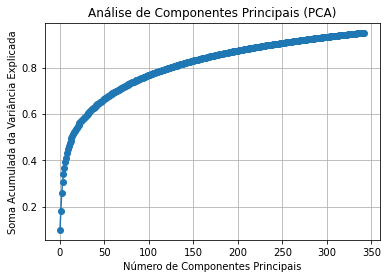

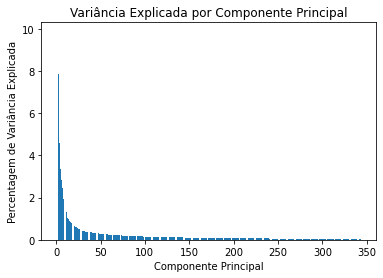

In [103]:
print('Explained Variance: %s'% str(pca.explained_variance_ratio_))

print(pca.explained_variance_ratio_.sum())

soma_acumulada_variancia = np.cumsum(pca.explained_variance_ratio_)

plt.plot(soma_acumulada_variancia, marker='o')
plt.xlabel('Número de Componentes Principais')
plt.ylabel('Soma Acumulada da Variância Explicada')
plt.title('Análise de Componentes Principais (PCA)')
plt.grid(True)
plt.show()

n_components = X_r.shape[1]
plt.bar(range(1, n_components + 1), pca.explained_variance_ratio_ * 100)
plt.xlabel("Componente Principal")
plt.ylabel("Percentagem de Variância Explicada")
plt.title("Variância Explicada por Componente Principal")
plt.show()

Recorrendo a esta análise, averiguam-se valores de PCA reduzidos, correspondendo aos primeiros dois PCAs os valores de 9,8% e 8,3%.

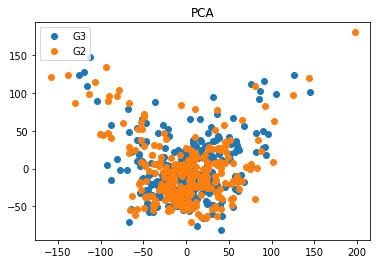

In [104]:
pca = PCA(n_components=0.9)
pca.fit(data_glioma)
X_reduced = pca.transform(data_glioma)
X_reduced.shape[1]

for act in unified_meta['GRADE'].unique():
    sp = unified_meta.index.get_indexer_for(unified_meta.index[unified_meta['GRADE'] == act]) - 1
    plt.plot(X_reduced[sp,0],X_reduced[sp,1],'o',label=act)
plt.title("PCA")
plt.legend(loc='best', shadow=False)
plt.show()

Analisando o gráfico apresentado, conclui-se, também, que os dados relativos aos dois graus de agressividade dos gliomas se sobrepõe, indicando desde já que o processo de _clustering_ poderá não ter muito sucesso.

### Análise de Variabilidade/Filtros

De modo a poder efetuar a filtração dos genes, foram aplicadas duas técnicas distintas de análise de variabilidade, Variance Threshold e Select Percentile. 

#### VarianceThreshold

O Variance Threshold permite identificar e remover características de um conjunto de dados que possuem variação inferior a um determinado limite predefinido. O pressuposto subjacente é que características com baixa variação não contribuem significativamente para o processo de modelação, uma vez que não apresentam variações significativas entre as instâncias de dados.

Neste caso, foi definido um valor limite de 0,03.

In [45]:
limiar_variancia = 0.03
seletor_variancia = VarianceThreshold(threshold=limiar_variancia)
dados_selecionados = seletor_variancia.fit_transform(data_glioma)

dados_selecionados.shape

(530, 20226)

In [46]:
colunas_selecionadas_booleano = seletor_variancia.get_support()

data_glioma_filtrado = data_glioma.iloc[:, colunas_selecionadas_booleano]
data_glioma_filtrado.head()

,LOC100130426,UBE2Q2P3,UBE2Q2P3,LOC149767,TIMM23,LOC155060,RNU12-2P,SSX9,CXORF67,EFCAB8,SRP14P1,LOC391343,TRIM75P,SPATA31B1P,LOC286106,SDR16C6P,LOC553137,KIAA1618,LOC645851,RGPD7,HSPB1P1,LOC594835,ANKRD20A20P,TMPRSS11E2,LOC100132347,EFCAB12,LOC147680,A1CF,RBFOX1,GGACT,A2ML1,A2M,P1,A4GNT,NPSR1-AS1,AAAS,LOC391856,AACS,AADACL2,LOC649285,AADACL4,AADAC,AADAT,AAGAB,DKFZp686K16132,AAMP,AANAT,LOC221410,AARSD1,AARS,AASDHPPT,AASDH,AASS,AATF,LOC100292717,NPD009,PRO2543,ABCA11P,ICR5,ABCA13,ABCA17P,TGD,ABCA2,ABCA3,STGD1,HSA275973,ABCA6,ABCA7,ABCA8,ABCA9,ABCB10,PFIC2,ABCB1,ABCB4,ABCB5,ABCB6,ABCB7,ABCB8,ABCB9,ABCC10,EWWD,ABCC12,ABCC13,ABCC1,ABCC2,ABCC3,ABCC4,ABCC5,ABCC6P1,ABCC6P2,PXE,ABCC8,ABCC9,ABCD1,ABCD2,ABCD3,ABCD4,ABCE1,ABCF1,ABCF2,ABCF3,ABCG1,ABCG2,ABCG4,ABCG5,LOC115232,ABHD10,ABHD11,ABHD12B,C20orf22,ABHD13,ABHD14A,ABHD14B,ABHD15,ABHD1,LOC654057,ABHD3,ABHD4,ABHD5,ABHD6,ABHD8,ABI1,ABI2,FLJ21551,ABI3,LOC116063,ABL2,ABLIM1,ABLIM2,ABLIM3,ABO,AOC1,ABRA,ABR,ABT1,ABTB1,ABTB2,ACAA1,LOC147548,ACACA,ACACB,ACAD10,ACAD11,ACAD8,ACAD9,ACADL,ACADM,LOC654185,ACADS,ACADVL,ACAN,ACAP1,ACAP2,ACAP3,ACAT1,ACAT2,ACBD3,ACBD4,ACBD5,ACBD6,ACBD7,LOC654199,ASIC1,ASIC3,ASIC4,ASIC5,ACCSL,ACCS,ACD,DKFZP434A014,ASAH3,ACER2,ACER3,LOC654142,ACEE,ACIN1,ACLY,ACMSD,SDHAF3,IREB1,LOC115645,ACOT11,ACOT12,ACOT13,LOC145480,ACOT2,ACOT4,ACOT6,ACOT7,ACOT8,ACOT9,ACOX1,ACOX2,ACOX3,ACOXL,ACP1,LOC96117,ACP5,LOC116107,PXYLP1,ACPP,ACPT,ACRBP,NAAR1,ACRV1,ACR,ACSBG1,ACSBG2,ACSF2,ACSF3,FACL1,PRO2194,MRX63,ACSL5,ACSL6,ACSM1,ACSM2A,ACSM2B,ACSM3,ACSM4,ACSM5,LOC89850,ACSS2,ACSS3,LOC115745,ACTA2,ACTBL2,LOC115571,ACTC1,DFNA26,LOC115664,ACTL6A,ACTL6B,ACTL7A,ACTL7B,ACTL8,ACTL9,ACTN1,ACTN2,ACTN3,FSGS1,ACTR10,ACTR1A,LOC130640,ACTR2,ACTR3B,LOC155033,ACTR3,ACTR5,ACTR6,ACTR8,ACTRT1,ACTRT2,ACVR1B,ACVR1C,FOP,ACVR2A,ACVR2B,ACVRL1,ACY1,ACY3,ACYP1,LOC115706,ADAD1,ADAD2,ADAL,ADAM10,ADAM11,CAR10,ADAM15,LOC129645,ADAM18,ADAM19,ADAM20,ADAM21P1,ADAM21,MDC2,ADAM23,EMDCII,ADAM29,ADAM2,ADAM30,ADAM32,DJ964F7.1,ADAM3A,ADAM5,ADAM6,ADAM7,ADAM8,ADAM9,ADAMDEC1,WMS,ADAMTS12,DKFZp434C2322,ADAMTS14,ADAMTS15,ADAMTS16,ADAMTS17,ADAMTS18,ADAMTS19,ADAMTS1,ADAMTS20,ADAMTS2,KIAA0366,ADAMTS4,ADAMTS5,LOC345667,DKFZP434H204,ADAMTS8,ADAMTS9,ADAMTSL1,ADAMTSL2,ADAMTSL3,LOC105371437,ADAMTSL5,ADAP1,ADAP2,ADARB1,LOC100130729,IFI4,ADAT1,ADAT2,ADAT3,ADA,ADCK1,ADCK2,ADCK4,ADCK5,ADCY10,DFNB44,ADCY2,AC3,ADCY4,ADCY5,ADCY6,ADCY7,ADCY8,ADCY9,ADCYAP1R1,ADCYAP1,AZIN2,ADD1,LOC130935,ADD3,ADH1A,ADH1B,ADH1C,ADH4,FDH,ADH6,ADH7,ADHFE1,ADI1,ADIG,APM-1,ADIPOR1,ADIPOR2,ADK,ADM2,ADM,ADNP2,LOC256440,ADORA1,ADORA2A,ADORA2B,ADORA3,ADO,ADPGK,ADPRHL1,ADPRHL2,ADPRH,ADRA1A,ADRA1B,ADRA1D,LOC92480,ADRA2B,ADRA2C,ADRB1,ADRB2,LOC157462,ADRBK1,ADRBK2,ADRM1,ADSL,ADSSL1,ADSS,AEBP1,AEBP2,AEN,AES,AFAP1L1,AFAP1L2,AFAP1,AKR7A2P1,PBM1,AFF2,AFF3,AFF4,FLJ45200,SCA28,AFMID,AFM,AFP,AFTPH,C11ORF96,AGAP11,AGAP1,KIAA0167,LOC100134082,AGAP4,LOC118704,AGAP6,AGAP7P,AGAP8,AGA,LOC728206,AGBL2,FLJ12983,AGBL4,AGBL5,AGER,AGFG1,RAB-R,HSU84971,AGK,AGL,LOC100507192,MGC5423,AGPAT2,AGPAT3,AGPAT4,AGPAT5,AGPAT6,AGPAT9,HYKK,AGPS,AGR2,AGR3,LOC348522,AGRP,AGTPBP1,AGTR1B,AGTR2,AGTRAP,AGT,ETNPPL,PHYKPL,AGXT2,AGXT,AHCTF1,LOC115541,AHCYL2,AHCY,AHDC1,AHI1,AHNAK2,AHNAKRS,LOC256948,AHR,AHSA1,AHSA2,AHSG,AHSP,AICDA,LOC92615,AIF1L,LOC116399,NAMSD,MGC13000,AIFM3,LOC51638,FLJ38020,ST4,AIM2,AIMP1,AIMP2,AIPL1,AIP,AIRE,AJAP1,AK1,AK2,AK4,AK3,AK5,AK7,AKAP10,AKAP11,GRAVIN,LBC,AKAP14,PRKA1,PRKA2,AKAP3,AKAP4,AKAP5,AKAP6,LOC51743,AKAP8L,AKAP8,AKAP450,AK9,AKIRIN1,AKIRIN2,AKNAD1,LOC158267,AKR1A1,AKR1B11,AKR1B15,AKR1B1,AKR1C1,TDD,HSD17B5,AKR1C4,AKR1C8P,AKR1D1,AKR1E2,LOC115578,AKR7A3,AKR7L,AKT1S1,AKT1,AKT2,AKT3,AKTIP,ALAD,ALAS1,LOC115365,ALB,ALCAM,ALDH16A1,LOC118736,ALDH1A1,ALDH1A2,LOC145757,ALDH1B1,ALDH1L1,ALDH1L2,ALDH2,ALDH3A1,ALDH3A2,LOC115175,ALDH3B2,ALDH4A1,ALDH5A1,LOC100506517,EPD,ALDH8A1,ALDH9A1,LOC115339,LOC138369,ALDOC,ALG10B,ALG10,ALG11,ALG12,LOC728848,LOC116072,ALG1L2,ALG1L,ALG1,ALG2,LOC131416,ALG5,LOC94752,ALG8,ALG9,ALKBH1,ALKBH2,LOC143968,ALKBH4,ALKBH5,ALKBH6,ALKBH7,ALKBH8,ALK,ALLC,ALMS1P,KIAA0328,ALOX12B,ALOX12P

Após ser aplicado o processo de seleção de atributos, foram analisados os PCAs resultantes, de modo a compreender se foi um processo eficaz.

In [47]:
n_components = 0.95
pca = PCA(n_components)
X_r = pca.fit_transform(data_glioma_filtrado)
print(X_r.shape[1])

343


Explained Variance: [0.09820889 0.08337117 0.07853298 0.04577847 0.03381319 0.02821899
 0.02468207 0.01954256 0.01786624 0.01730621 0.01417395 0.01319373
 0.01024939 0.01007851 0.00910117 0.00862489 0.00781989 0.00760049
 0.0069229  0.00651613 0.00636421 0.00591462 0.00586989 0.00550906
 0.00533685 0.0050477  0.00457406 0.00449601 0.00435603 0.00421229
 0.00417404 0.00402551 0.0039159  0.00387418 0.00377136 0.00369383
 0.00360609 0.00356572 0.00348201 0.00346697 0.00341457 0.00333518
 0.00332128 0.0032798  0.00319271 0.00312147 0.00306295 0.00300731
 0.00293272 0.00290604 0.00285293 0.00279247 0.00275784 0.00273304
 0.00272274 0.0026979  0.00259258 0.00255221 0.00250238 0.00247083
 0.00240041 0.00235183 0.00234201 0.00229324 0.00227531 0.00225946
 0.00225071 0.00223408 0.00221142 0.00213458 0.00212523 0.00209178
 0.00207581 0.00205961 0.00202902 0.00201593 0.00199999 0.00197011
 0.00194295 0.0019151  0.00190144 0.00185984 0.00182402 0.00178318
 0.0017798  0.00177285 0.00176497 0.001723

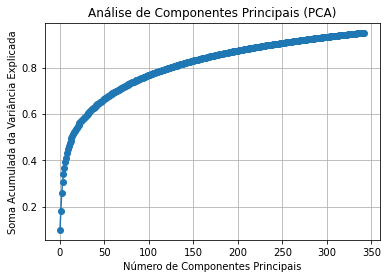

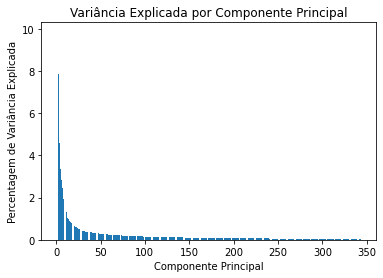

In [48]:
print('Explained Variance: %s'% str(pca.explained_variance_ratio_))

print(pca.explained_variance_ratio_.sum())

soma_acumulada_variancia = np.cumsum(pca.explained_variance_ratio_)

plt.plot(soma_acumulada_variancia, marker='o')
plt.xlabel('Número de Componentes Principais')
plt.ylabel('Soma Acumulada da Variância Explicada')
plt.title('Análise de Componentes Principais (PCA)')
plt.grid(True)
plt.show()

n_components = X_r.shape[1]
plt.bar(range(1, n_components + 1), pca.explained_variance_ratio_ * 100)
plt.xlabel("Componente Principal")
plt.ylabel("Percentagem de Variância Explicada")
plt.title("Variância Explicada por Componente Principal")
plt.show()

Avaliando os resultados, conclui-se que a variância explicada pelos primeiros PCAs é ainda menor do que originalmente, podendo indicar que foram removidos atributos com significância para o estudo, o que não é ideal.

#### SelectPercentile

Ao contrário do Variance Threshold, o SelectPercentile não se concentra na variação intrínseca das características, mas sim em métricas estatísticas, como o F-score, para avaliar a relação entre cada característica e o _target_.

Neste caso, foram estabelecidos dois quartis, a 25% e 75%, importantes para definir o intervalo interquartis (IQR). É, então, definido um limite para identificação de outliers para cada coluna e mantidas apenas as colunas cujo IQR é inferior a esse limite. Isso é feito para remover colunas que contenham valores atípicos ou extremos em relação à distribuição dos dados.

In [49]:
Q1 = data_glioma.quantile(0.25)
Q3 = data_glioma.quantile(0.75)
iqr = Q3 - Q1
cutoff = iqr.quantile(0.3)
colunas_manter = iqr[iqr < cutoff].index
data_manter = data_glioma[colunas_manter]
data_manter.shape

(530, 6172)

#### Junção dos datasets

Visto que foi removida uma linha anteriormente do dataset conjugado entre dados do paciente e amostras, e que no dataset referente aos genes existem 530 colunas, ou seja uma mais do que no anterior, foi necessário conjugar os três, obtendo-se, posteriormente, apenas os atributos relativos aos genes no dataset _dg_merged_.

In [50]:
merged_df_sp = subset_meta.join(data_manter, on = "Sample Identifier" )
merged_df_sp.head()
dg_merged = merged_df_sp.iloc[:, 5:]

In [51]:
dg_merged.shape

(529, 6172)

Tendo o dataset referente aos genes adequado às amostras consideradas, é aplicada a técnica de Select Percentile, considerando um p-value inferior a 0,01. Este valor foi definido, tendo em conta que valores de p-value menores indicam maior variância nos dados.

In [52]:
selector = SelectPercentile(f_classif, percentile=10)

dg_filtered = pd.DataFrame(selector.fit_transform(dg_merged, unified_meta["GRADE"]))

# Obter índices dos atributos selecionados
indices_significantes = np.where(selector.pvalues_ < 0.01)[0]

# Obter os nomes das colunas correspondentes
colunas_significantes = dg_merged.columns[indices_significantes]
print(colunas_significantes)
novo_dataset = dg_merged.iloc[:, indices_significantes]

# Criar dataset com p-values ordenados
p_values_ordered = pd.DataFrame({
    'Atributo': colunas_significantes,
    'P-Valor': selector.pvalues_[indices_significantes]
}).sort_values(by='P-Valor')

# Definir o limite para p-value
limite_pvalue = 0.01

# Filtrar o dataset para manter apenas os atributos com p-value inferior ao limite
atributos_selecionados = p_values_ordered[p_values_ordered['P-Valor'] < limite_pvalue]['Atributo']

if not atributos_selecionados.empty:
    # Garantir que apenas as colunas originais, cujos índices correspondem aos selecionados, estejam em dg_final e não de acordo com o nome
    dg_final = subset_meta.join(novo_dataset, on="Sample Identifier")

    # Imprimir os atributos finais e o dataset final
    print(atributos_selecionados)
else:
    print("Nenhum atributo selecionado com p-value inferior ao limite.")


C:\Users\Carla Passos\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [   1    3   10 1293 1294 1295 1297 1298 1299 1400 1436 1442 1445 1448
 1449 1454 1455 1457 1584 1758 2013 2015 2018 2021 2289 2290 2291 2292
 2293 2329 2357 2456 2864 2872 2874 2881 2883 2884 2888 2889 2955 3060
 3183 3553 3554 3630 3998 4002 4305 4418 4473 4474 4475 4476 4596 4598
 4603 4679 4681 4682 5050 5051 5052 5053 5055 5056 5057 5059 5062 5063
 5064 5068 5098 5138 5154 5155 5156 5157 5158 5159 5161 5162 5163 5164
 5165 5166 5167 5168 5169 5170 5171 5172 5173 5174 5175 5176 5177 5178
 5179 5180 5181 5182 5183 5184 5185 5186 5187 5188 5189 5190 5191 5192
 5193 5194 5195 5196 5197 5198 5199 5200 5201 5202 5203 5204 5205 5206
 5207 5208 5209 5210 5211 5212 5213 5214 5215 5216 5217 5218 5219 5220
 5221 5222 5223 5224 5225 5226 5227 5229 5230 5231 5232 5233 5234 5235
 5236 5237 5238 5239 5240 5241 5242 5243 5244 5245 5246 5247 5248 5249
 5250 5251 5252 5253

Index(['HSPB1P1', 'LOC594835', 'EFCAB12', 'RBFOX1', 'ABCB4', 'ABCB5', 'ABCC1',
       'ABCC3', 'ABCG4', 'LOC115232',
       ...
       'ZNF232', 'UAN', 'LOC102724263', 'ZNF468', 'ZNF474', 'ZNF593', 'ZNF648',
       'ZNF683', 'ZYG11A', 'ZYX'],
      dtype='object', length=1691)
1404                SHCBP1
84                   ASF1B
95                   AURKA
134               FLJ13936
1357                  RRM2
1446                  SMC4
1411                  SKA1
850                 IQGAP3
1025                  MCM2
452                   DSN1
1580                FLS353
308                  CENPK
684                   GPX6
1208                  PCNA
466                   ECT2
502                 ERCC6L
1110                  NEK2
899              LOC158832
138                 PARPBP
1026                  MCM8
696                  GTSE1
454                    DTL
282                 CDC25C
895                 KIF20A
744                  HJURP
550              LOC116044
304                 

Sendo definidos quais os genes com maior variância de acordo com o _target_, é criado um dataset contendo somente estes genes, assim como os atributos definidos anteriormente.

In [53]:
dg_final.head()

CANCER_TYPE_DETAILED GRADE  OS_MONTHS  \
Sample Identifier                                            
TCGA-CS-6290-01    Anaplastic Astrocytoma    G3      37.35   
TCGA-DU-5847-01    Anaplastic Astrocytoma    G3      18.00   
TCGA-DU-5849-01         Oligodendroglioma    G2      14.55   
TCGA-DU-5852-01          Oligoastrocytoma    G3       6.73   
TCGA-DU-5854-01    Anaplastic Astrocytoma    G3       8.44   

                  HISTORY_NEOADJUVANT_MEDICATION VITAL_STATUS   HSPB1P1  \
Sample Identifier                                                         
TCGA-CS-6290-01                               NO         Dead  0.080275   
TCGA-DU-5847-01                              YES        Alive -0.056983   
TCGA-DU-5849-01                              YES        Alive -0.292196   
TCGA-DU-5852-01                              YES         Dead -0.411713   
TCGA-DU-5854-01                              YES        Alive -0.308205   

                   LOC594835   EFCAB12    RBFOX1     ABCB4     ABCB5  \
Sample Identifier                                                      
TCGA-CS-6290-01    -0.294840 -0.203031 -0.518017  0.081964 -0.262347   
TCGA-DU-5847-01    -0.294840  1.780624 -0.505555  0.262694 -0.262347   
TCGA-DU-5849-01    -0.005926 -0.241374  0.611050 -0.723853  0.006408   
TCGA-DU-5852-01    -0.191396 -0.214607 -0.316780  0.703424  0.047755   
TCGA-DU-5854-01    -0.294840 -0.248955 -0.517876  0.918811  0.409100   

                      ABCC1     ABCC3     ABCG4  LOC115232    ABLIM2  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.301168 -0.186414 -0.468095  -0.530082 -0.616220   
TCGA-DU-5847-01    0.912783  0.164827 -0.593642  -0.381347 -0.156944   
TCGA-DU-5849-01   -0.149890 -0.271192  0.613586   0.829230  0.902595   
TCGA-DU-5852-01   -0.458795  0.318510 -0.187745  -0.007327 -0.480319   
TCGA-DU-5854-01   -0.284614  0.701932 -0.523873  -0.530082 -0.372488   

                      ACAP1  LOC654142    ACOT12     ACSM4     ACSS3  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.164649  -0.509361 -0.280884  3.600320 -0.440262   
TCGA-DU-5847-01    1.702275  -0.497635 -0.120485 -0.187183  1.190199   
TCGA-DU-5849-01   -0.237674  -0.358604 -0.280884 -0.187183  0.267515   
TCGA-DU-5852-01   -0.113579   3.188663  0.658703  2.896588  4.041127   
TCGA-DU-5854-01    0.092309   1.224083  0.736279 -0.187183  2.814307   

                      ACTN1    ADAM11     CAR10    ADAM19  DJ964F7.1  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.228095 -0.628817 -0.222960 -0.489427  -0.313958   
TCGA-DU-5847-01    0.236293 -0.504892  0.513713  0.125574  -0.001179   
TCGA-DU-5849-01   -0.120357  0.577775 -0.229843 -0.358272  -0.215338   
TCGA-DU-5852-01    0.203834 -0.320190  0.587429  4.253379   0.989788   
TCGA-DU-5854-01    0.760488 -0.548709  0.646358  0.880857   0.293811   

                   ADAMTS18  KIAA0366  DKFZP434H204  LOC105371437      ADH4  \
Sample Identifier                                                             
TCGA-CS-6290-01   -0.434897 -0.246135     -0.356075     -0.084831  0.025454   
TCGA-DU-5847-01   -0.129311  0.773387     -0.138741      0.452444  1.164144   
TCGA-DU-5849-01   -0.390566 -0.036055     -0.277698     -0.404890 -0.048056   
TCGA-DU-5852-01    1.318624  0.454701      0.342148      0.357510 -0.224273   
TCGA-DU-5854-01    3.583116 -0.117283     -0.069700      1.526503 -0.224273   

                       ADIG      ADM2       ADM     AEBP1   AFAP1L1     AGBL2  \
Sample Identifier                                                               
TCGA-CS-6290-01    1.455474 -0.045111 -0.376704 -0.187717 -0.537096 -0.215383   
TCGA-DU-5847-01    2.592858  0.987412 -0.277294  0.277505 -0.001402  6.414442   
TCGA-DU-5849-01   -0.535188 -0.165346 -0.348103 -0.331682 -0.288725 -0.357672   
TCGA-DU-5852-01    1.015242  1.621452 -0.165570  0.395230  6.379275 -0.151754   


In [54]:
colunas_duplicadas = dg_final.columns[dg_final.columns.duplicated()]
print(colunas_duplicadas)
dg_final = dg_final.loc[:, ~dg_final.columns.duplicated()]

Index(['C5orf23', 'CACNG5'], dtype='object')


Averiguou-se, também, que existiam colunas duplicadas, sendo que tal não faria sentido, efetuando-se a remoção destas.

In [55]:
dg_final.shape

(529, 1694)

Para compreender um pouco melhor se os genes selecionados têm, efetivamente, elevada relação com o objetivo _GRADE_, foram efetuados os gráficos destas relações para os 5 genes apresentados como tendo maior variância.

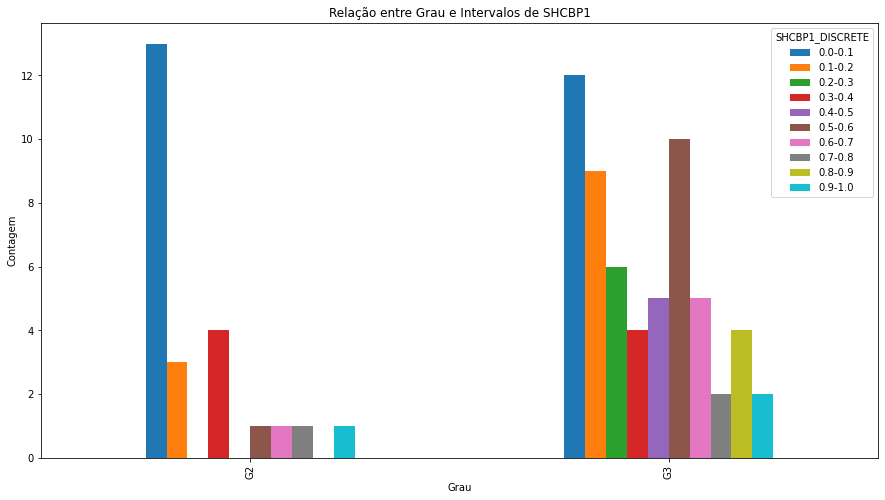

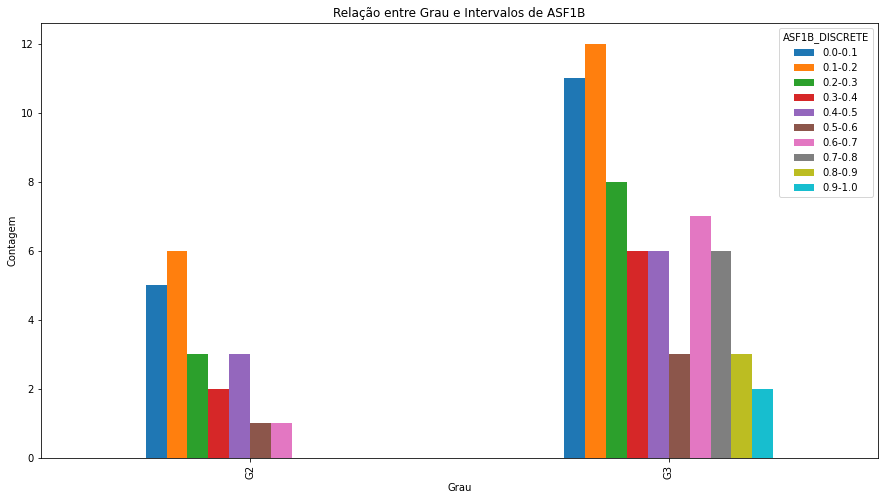

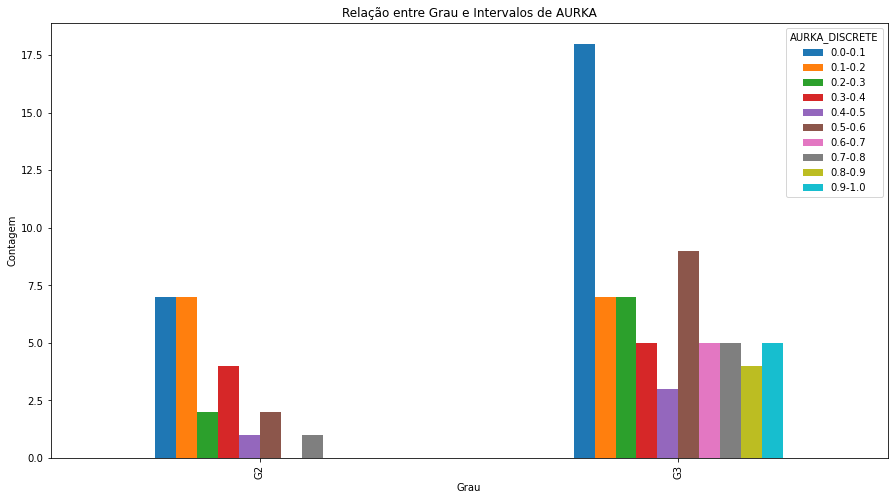

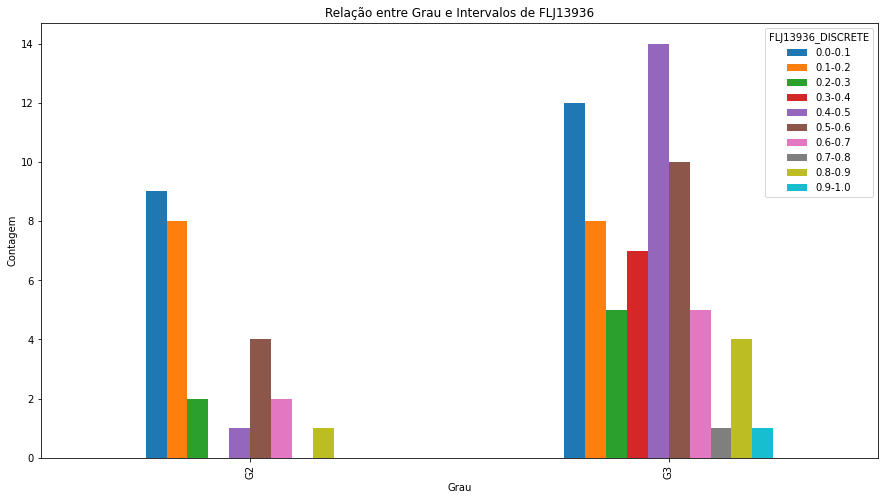

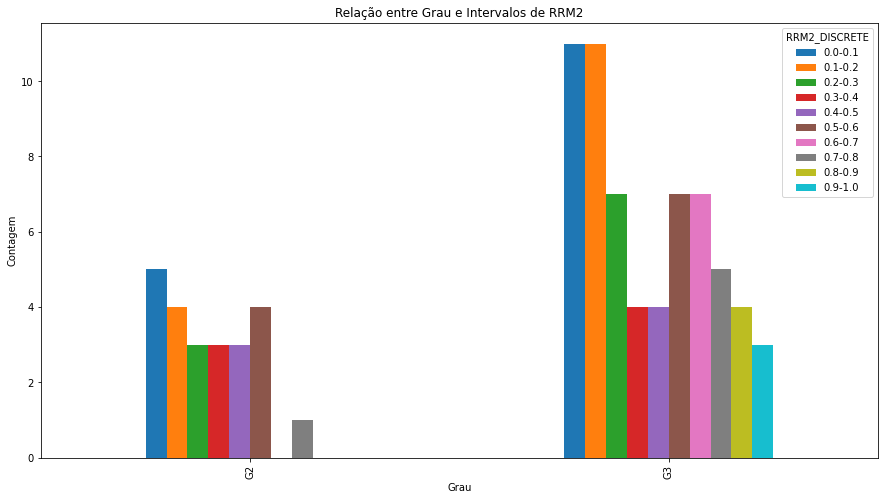

In [56]:
# Gene SHCBP1
bins_SHCBP1 = np.arange(0, 1.1, 0.1)  # Intervalos de 0.1
labels_SHCBP1 = [f"{i:.1f}-{i+0.1:.1f}" for i in np.arange(0, 1, 0.1)]

# Discretizar a variável numérica IQGAP3 em intervalos sem modificar dg_final
dg_filtered = dg_final.copy()
dg_filtered['SHCBP1_DISCRETE'] = pd.cut(dg_filtered['SHCBP1'], bins=bins_SHCBP1, labels=labels_SHCBP1)

# Criar a matriz de contingência
matriz_contingencia_SHCBP1 = pd.crosstab(dg_filtered['GRADE'], dg_filtered['SHCBP1_DISCRETE'])

cores = sns.color_palette()
matriz_contingencia_SHCBP1.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e Intervalos de SHCBP1')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()


# Gene ASF1B
bins_ASF1B = np.arange(0, 1.1, 0.1)  # Intervalos de 0.1
labels_ASF1B = [f"{i:.1f}-{i+0.1:.1f}" for i in np.arange(0, 1, 0.1)] 

dg_filtered['ASF1B_DISCRETE'] = pd.cut(dg_filtered['ASF1B'], bins=bins_ASF1B, labels=labels_ASF1B)

matriz_contingencia_ASF1B = pd.crosstab(dg_filtered['GRADE'], dg_filtered['ASF1B_DISCRETE'])

cores = sns.color_palette()
matriz_contingencia_ASF1B.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e Intervalos de ASF1B')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()


# Gene AURKA
bins_AURKA = np.arange(0, 1.1, 0.1)  # Intervalos de 0.1
labels_AURKA = [f"{i:.1f}-{i+0.1:.1f}" for i in np.arange(0, 1, 0.1)]  # Rótulos para os intervalos

dg_filtered['AURKA_DISCRETE'] = pd.cut(dg_filtered['AURKA'], bins=bins_AURKA, labels=labels_AURKA)

matriz_contingencia_AURKA = pd.crosstab(dg_filtered['GRADE'], dg_filtered['AURKA_DISCRETE'])

cores = sns.color_palette()
matriz_contingencia_AURKA.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e Intervalos de AURKA')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Gene FLJ13936
bins_FLJ13936 = np.arange(0, 1.1, 0.1)
labels_FLJ13936 = [f"{i:.1f}-{i+0.1:.1f}" for i in np.arange(0, 1, 0.1)]

dg_filtered['FLJ13936_DISCRETE'] = pd.cut(dg_filtered['FLJ13936'], bins=bins_FLJ13936, labels=labels_FLJ13936)
matriz_contingencia_FLJ13936 = pd.crosstab(dg_filtered['GRADE'], dg_filtered['FLJ13936_DISCRETE'])

matriz_contingencia_FLJ13936.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e Intervalos de FLJ13936')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

# Gene RRM2
bins_RRM2 = np.arange(0, 1.1, 0.1)
labels_RRM2 = [f"{i:.1f}-{i+0.1:.1f}" for i in np.arange(0, 1, 0.1)]

dg_filtered['RRM2_DISCRETE'] = pd.cut(dg_filtered['RRM2'], bins=bins_RRM2, labels=labels_RRM2)
matriz_contingencia_RRM2 = pd.crosstab(dg_filtered['GRADE'], dg_filtered['RRM2_DISCRETE'])

matriz_contingencia_RRM2.plot(kind='bar', figsize=(15, 8), color=cores)
plt.title('Relação entre Grau e Intervalos de RRM2')
plt.xlabel('Grau')
plt.ylabel('Contagem')
plt.show()

Para o gene com indicação de maior variância, SHCBP1, observam-se taxas maiores para gliomas de grau 3. Tal é apoiado pela literatura, tendo-se estabelecido que a elevada expressividade deste gene promove a migração de células de glioma e a agressividade deste pela ativação da via de sinalização NF-κB [13]. Esta via é um sistema crucial de transdução de sinal em células eucarióticas, desempenhando um papel fundamental na regulação da resposta imunológica, inflamação, sobrevivência celular, e desenvolvimento.

Relativamente aos restantes genes, ASF1B, AURKA, FLJ13936, RRM2, acontece algo semelhante, o aumento da sua expressividade causa um aumento na agressividade do glioma.

Segundo a literatura, estes dados são tembém apoiados. 

O gene ASF1B é considerado um bom marcador da presença de gliomas mais agressivos [14].

Já o gene AURKA, está altamente relacionado com a progressão de gliomas, ativando a autorenovação das células tumorais [15]. 

Em relação ao gene RRM2, este contribui para a migração e proliferação de células de glioma por meio das vias de sinalização ERK1/2 e AKT. A via de sinalização ERK1/2 desencadeia respostas celulares, incluindo proliferação e sobrevivência, em resposta a estímulos externos. Enquanto isso, a via de sinalização AKT regula processos celulares como crescimento, sobrevivência e metabolismo [16].

In [57]:
dg_final_genes = dg_final.iloc[:, 5:]
n_components = 0.9
pca = PCA(n_components)
X_r = pca.fit_transform(dg_final_genes)
print(X_r.shape[1])

116


Explained Variance: [0.18560798 0.11857245 0.08154641 0.05336693 0.03100314 0.02724871
 0.02146038 0.0188949  0.01634476 0.01522786 0.01229508 0.01045101
 0.00994742 0.00845535 0.00770052 0.00757635 0.00727613 0.00686247
 0.00661471 0.00637408 0.00625319 0.00603715 0.00583087 0.00558988
 0.00538352 0.00522455 0.00513484 0.00507852 0.00473249 0.00455177
 0.00438072 0.00434323 0.00428271 0.00423386 0.0041504  0.00403922
 0.00392752 0.00378321 0.00373956 0.0036415  0.00350314 0.0034022
 0.00331865 0.00327545 0.0032438  0.00313565 0.00308505 0.00302668
 0.00295223 0.00288629 0.00286262 0.0028123  0.00279461 0.00276256
 0.00273602 0.00267655 0.00267174 0.00259047 0.0025184  0.00249252
 0.00241879 0.00236192 0.00231695 0.0023126  0.00228959 0.00226322
 0.00224865 0.00220731 0.00217703 0.00214478 0.0021095  0.00209087
 0.00205735 0.00202908 0.00197519 0.00196102 0.0019204  0.00188985
 0.00186752 0.00183737 0.00182282 0.00179915 0.00176509 0.00172236
 0.00171211 0.00166952 0.0016625  0.0016338

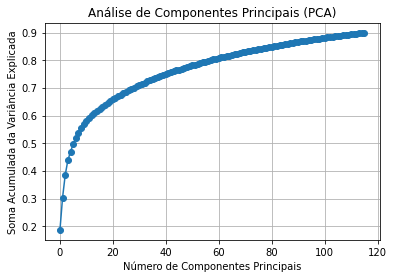

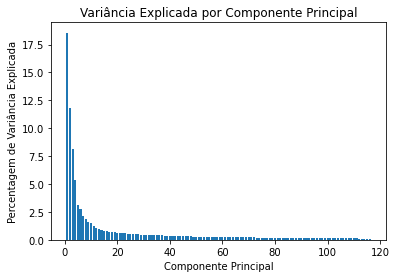

In [58]:
print('Explained Variance: %s'% str(pca.explained_variance_ratio_))

print(pca.explained_variance_ratio_.sum())


soma_acumulada_variancia = np.cumsum(pca.explained_variance_ratio_)

plt.plot(soma_acumulada_variancia, marker='o')
plt.xlabel('Número de Componentes Principais')
plt.ylabel('Soma Acumulada da Variância Explicada')
plt.title('Análise de Componentes Principais (PCA)')
plt.grid(True)
plt.show()

n_components =X_r.shape[1]
plt.bar(range(1, n_components + 1), pca.explained_variance_ratio_ * 100)
plt.xlabel("Componente Principal")
plt.ylabel("Percentagem de Variância Explicada")
plt.title("Variância Explicada por Componente Principal")
plt.show()


Analisando os PCAs obtidos, observa-se um aumento da variância nestes, sendo que se obtem, por exemplo, para os dois primeiros PCAs valores de 18,6% e 11,9%, o que se destaca quando comparados com os valores anteriores. Isto indica que, com os primeiros 116 PCAs, se obtém 90% da variância dos dados, sendo os genes selecionados relevantes para o estudo em questão. Adicionalmente, com esta técnica, garante-se que os genes selecionados estão realmente relacionados com o _target_. 

### Clustering

In [59]:
dg_final_genes.head()

HSPB1P1  LOC594835   EFCAB12    RBFOX1     ABCB4  \
Sample Identifier                                                      
TCGA-CS-6290-01    0.080275  -0.294840 -0.203031 -0.518017  0.081964   
TCGA-DU-5847-01   -0.056983  -0.294840  1.780624 -0.505555  0.262694   
TCGA-DU-5849-01   -0.292196  -0.005926 -0.241374  0.611050 -0.723853   
TCGA-DU-5852-01   -0.411713  -0.191396 -0.214607 -0.316780  0.703424   
TCGA-DU-5854-01   -0.308205  -0.294840 -0.248955 -0.517876  0.918811   

                      ABCB5     ABCC1     ABCC3     ABCG4  LOC115232  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.262347 -0.301168 -0.186414 -0.468095  -0.530082   
TCGA-DU-5847-01   -0.262347  0.912783  0.164827 -0.593642  -0.381347   
TCGA-DU-5849-01    0.006408 -0.149890 -0.271192  0.613586   0.829230   
TCGA-DU-5852-01    0.047755 -0.458795  0.318510 -0.187745  -0.007327   
TCGA-DU-5854-01    0.409100 -0.284614  0.701932 -0.523873  -0.530082   

                     ABLIM2     ACAP1  LOC654142    ACOT12     ACSM4  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.616220 -0.164649  -0.509361 -0.280884  3.600320   
TCGA-DU-5847-01   -0.156944  1.702275  -0.497635 -0.120485 -0.187183   
TCGA-DU-5849-01    0.902595 -0.237674  -0.358604 -0.280884 -0.187183   
TCGA-DU-5852-01   -0.480319 -0.113579   3.188663  0.658703  2.896588   
TCGA-DU-5854-01   -0.372488  0.092309   1.224083  0.736279 -0.187183   

                      ACSS3     ACTN1    ADAM11     CAR10    ADAM19  \
Sample Identifier                                                     
TCGA-CS-6290-01   -0.440262 -0.228095 -0.628817 -0.222960 -0.489427   
TCGA-DU-5847-01    1.190199  0.236293 -0.504892  0.513713  0.125574   
TCGA-DU-5849-01    0.267515 -0.120357  0.577775 -0.229843 -0.358272   
TCGA-DU-5852-01    4.041127  0.203834 -0.320190  0.587429  4.253379   
TCGA-DU-5854-01    2.814307  0.760488 -0.548709  0.646358  0.880857   

                   DJ964F7.1  ADAMTS18  KIAA0366  DKFZP434H204  LOC105371437  \
Sample Identifier                                                              
TCGA-CS-6290-01    -0.313958 -0.434897 -0.246135     -0.356075     -0.084831   
TCGA-DU-5847-01    -0.001179 -0.129311  0.773387     -0.138741      0.452444   
TCGA-DU-5849-01    -0.215338 -0.390566 -0.036055     -0.277698     -0.404890   
TCGA-DU-5852-01     0.989788  1.318624  0.454701      0.342148      0.357510   
TCGA-DU-5854-01     0.293811  3.583116 -0.117283     -0.069700      1.526503   

                       ADH4      ADIG      ADM2       ADM     AEBP1   AFAP1L1  \
Sample Identifier                                                               
TCGA-CS-6290-01    0.025454  1.455474 -0.045111 -0.376704 -0.187717 -0.537096   
TCGA-DU-5847-01    1.164144  2.592858  0.987412 -0.277294  0.277505 -0.001402   
TCGA-DU-5849-01   -0.048056 -0.535188 -0.165346 -0.348103 -0.331682 -0.288725   
TCGA-DU-5852-01   -0.224273  1.015242  1.621452 -0.165570  0.395230  6.379275   
TCGA-DU-5854-01   -0.224273 -0.230021  0.138866 -0.136875  0.737511  3.777031   

                      AGBL2      AGR3    AGTR1B       AHR       ST4       AK5  \
Sample Identifier                                                               
TCGA-CS-6290-01   -0.215383 -0.159024  0.005545 -0.072037 -0.017270 -0.313099   
TCGA-DU-5847-01    6.414442  0.478680  0.738122  0.588787  0.525928 -0.502146   
TCGA-DU-5849-01   -0.357672 -0.159024 -0.041322 -0.082270 -0.287260  0.745567   
TCGA-DU-5852-01   -0.151754 -0.159024 -0.080010 -0.610657  0.301423 -0.378234   
TCGA-DU-5854-01    0.835649 -0.159024  0.061679  0.196028  0.211717  0.268467   

                      AKAP5    AKNAD1  ALOX12P2     ALPK2     ALPK3  ALS2CR12  \
Sample Identifier                                                               
TCGA-CS-6290-01   -0.526272 -0.279601 -0.586622 -0.279314 -0.157265 -0.238694   
TCGA-DU-5847-01   -0.123083 -0.174578  5.602755 -0.295974  3.733511

In [60]:
dg_final_genes.shape, subset_meta.shape

((529, 1689), (529, 5))

In [61]:
dg_final.head()

CANCER_TYPE_DETAILED GRADE  OS_MONTHS  \
Sample Identifier                                            
TCGA-CS-6290-01    Anaplastic Astrocytoma    G3      37.35   
TCGA-DU-5847-01    Anaplastic Astrocytoma    G3      18.00   
TCGA-DU-5849-01         Oligodendroglioma    G2      14.55   
TCGA-DU-5852-01          Oligoastrocytoma    G3       6.73   
TCGA-DU-5854-01    Anaplastic Astrocytoma    G3       8.44   

                  HISTORY_NEOADJUVANT_MEDICATION VITAL_STATUS   HSPB1P1  \
Sample Identifier                                                         
TCGA-CS-6290-01                               NO         Dead  0.080275   
TCGA-DU-5847-01                              YES        Alive -0.056983   
TCGA-DU-5849-01                              YES        Alive -0.292196   
TCGA-DU-5852-01                              YES         Dead -0.411713   
TCGA-DU-5854-01                              YES        Alive -0.308205   

                   LOC594835   EFCAB12    RBFOX1     ABCB4     ABCB5  \
Sample Identifier                                                      
TCGA-CS-6290-01    -0.294840 -0.203031 -0.518017  0.081964 -0.262347   
TCGA-DU-5847-01    -0.294840  1.780624 -0.505555  0.262694 -0.262347   
TCGA-DU-5849-01    -0.005926 -0.241374  0.611050 -0.723853  0.006408   
TCGA-DU-5852-01    -0.191396 -0.214607 -0.316780  0.703424  0.047755   
TCGA-DU-5854-01    -0.294840 -0.248955 -0.517876  0.918811  0.409100   

                      ABCC1     ABCC3     ABCG4  LOC115232    ABLIM2  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.301168 -0.186414 -0.468095  -0.530082 -0.616220   
TCGA-DU-5847-01    0.912783  0.164827 -0.593642  -0.381347 -0.156944   
TCGA-DU-5849-01   -0.149890 -0.271192  0.613586   0.829230  0.902595   
TCGA-DU-5852-01   -0.458795  0.318510 -0.187745  -0.007327 -0.480319   
TCGA-DU-5854-01   -0.284614  0.701932 -0.523873  -0.530082 -0.372488   

                      ACAP1  LOC654142    ACOT12     ACSM4     ACSS3  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.164649  -0.509361 -0.280884  3.600320 -0.440262   
TCGA-DU-5847-01    1.702275  -0.497635 -0.120485 -0.187183  1.190199   
TCGA-DU-5849-01   -0.237674  -0.358604 -0.280884 -0.187183  0.267515   
TCGA-DU-5852-01   -0.113579   3.188663  0.658703  2.896588  4.041127   
TCGA-DU-5854-01    0.092309   1.224083  0.736279 -0.187183  2.814307   

                      ACTN1    ADAM11     CAR10    ADAM19  DJ964F7.1  \
Sample Identifier                                                      
TCGA-CS-6290-01   -0.228095 -0.628817 -0.222960 -0.489427  -0.313958   
TCGA-DU-5847-01    0.236293 -0.504892  0.513713  0.125574  -0.001179   
TCGA-DU-5849-01   -0.120357  0.577775 -0.229843 -0.358272  -0.215338   
TCGA-DU-5852-01    0.203834 -0.320190  0.587429  4.253379   0.989788   
TCGA-DU-5854-01    0.760488 -0.548709  0.646358  0.880857   0.293811   

                   ADAMTS18  KIAA0366  DKFZP434H204  LOC105371437      ADH4  \
Sample Identifier                                                             
TCGA-CS-6290-01   -0.434897 -0.246135     -0.356075     -0.084831  0.025454   
TCGA-DU-5847-01   -0.129311  0.773387     -0.138741      0.452444  1.164144   
TCGA-DU-5849-01   -0.390566 -0.036055     -0.277698     -0.404890 -0.048056   
TCGA-DU-5852-01    1.318624  0.454701      0.342148      0.357510 -0.224273   
TCGA-DU-5854-01    3.583116 -0.117283     -0.069700      1.526503 -0.224273   

                       ADIG      ADM2       ADM     AEBP1   AFAP1L1     AGBL2  \
Sample Identifier                                                               
TCGA-CS-6290-01    1.455474 -0.045111 -0.376704 -0.187717 -0.537096 -0.215383   
TCGA-DU-5847-01    2.592858  0.987412 -0.277294  0.277505 -0.001402  6.414442   
TCGA-DU-5849-01   -0.535188 -0.165346 -0.348103 -0.331682 -0.288725 -0.357672   
TCGA-DU-5852-01    1.015242  1.621452 -0.165570  0.395230  6.379275 -0.151754   


In [62]:
print(dg_final.shape)
merged_df= dg_final

(529, 1694)


No processo de clustering, a seleção do atributo a prever é altamente importante, caso existam dados para tal. Assim, procurou-se compreender se o atributo alvo definido continuaria a fazer sentido para este processo em específico. 

Foram, então, analisadas as distribuições dos dados de acordo com os atributos _GRADE_, _VITAL_STATUS_ e _CANCER_TYPE_DETAILED_.

In [63]:
pca = PCA(n_components=0.9)
pca.fit(dg_final_genes)
X_reduced = pca.transform(dg_final_genes)
X_reduced.shape[1]

116

In [64]:
print('Var. explained: %s'% str(pca.explained_variance_ratio_))

Var. explained: [0.18560798 0.11857245 0.08154641 0.05336693 0.03100314 0.02724871
 0.02146038 0.0188949  0.01634476 0.01522786 0.01229508 0.01045101
 0.00994742 0.00845535 0.00770052 0.00757635 0.00727613 0.00686247
 0.00661471 0.00637408 0.00625319 0.00603715 0.00583087 0.00558988
 0.00538352 0.00522455 0.00513484 0.00507852 0.00473249 0.00455177
 0.00438072 0.00434323 0.00428271 0.00423386 0.0041504  0.00403922
 0.00392752 0.00378321 0.00373956 0.0036415  0.00350314 0.0034022
 0.00331865 0.00327545 0.0032438  0.00313565 0.00308505 0.00302668
 0.00295223 0.00288629 0.00286262 0.0028123  0.00279461 0.00276256
 0.00273602 0.00267655 0.00267174 0.00259047 0.0025184  0.00249252
 0.00241879 0.00236192 0.00231695 0.0023126  0.00228959 0.00226322
 0.00224865 0.00220731 0.00217703 0.00214478 0.0021095  0.00209087
 0.00205735 0.00202908 0.00197519 0.00196102 0.0019204  0.00188985
 0.00186752 0.00183737 0.00182282 0.00179915 0.00176509 0.00172236
 0.00171211 0.00166952 0.0016625  0.00163384 0.

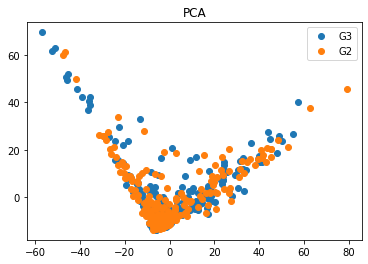

In [65]:
for act in merged_df['GRADE'].unique():
    sp = merged_df.index.get_indexer_for(merged_df.index[merged_df['GRADE'] == act]) - 1
    plt.plot(X_reduced[sp,0],X_reduced[sp,1],'o',label=act)
plt.title("PCA")
plt.legend(loc='best', shadow=False)
plt.show()

In [93]:
tsne = TSNE(n_components=2, n_iter=1000)
tsne_results = tsne.fit_transform(dg_final_genes)

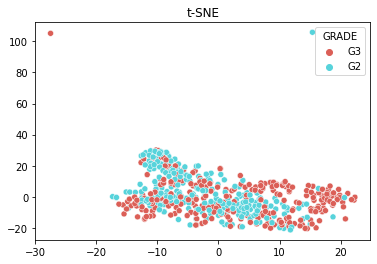

In [94]:
num_unique_grades = merged_df['GRADE'].nunique()

palette = sns.color_palette("hls", num_unique_grades)

fig = sns.scatterplot(
    x=tsne_results[:,0], y=tsne_results[:,1],
    hue="GRADE",
    palette=palette,
    data=dg_final,
    legend="full",
).set(title="t-SNE")

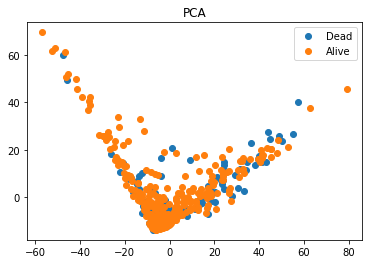

In [66]:
for act in merged_df['VITAL_STATUS'].unique():
    sp = merged_df.index.get_indexer_for(merged_df.index[merged_df['VITAL_STATUS'] == act]) - 1
    plt.plot(X_reduced[sp,0],X_reduced[sp,1],'o',label=act)
plt.title("PCA")
plt.legend(loc='best', shadow=False)
plt.show()

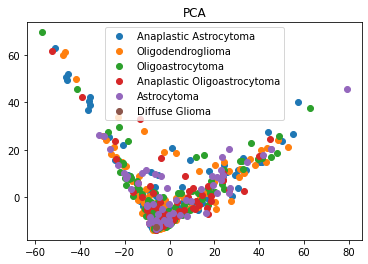

In [67]:
for act in merged_df['CANCER_TYPE_DETAILED'].unique():
    sp = merged_df.index.get_indexer_for(merged_df.index[merged_df['CANCER_TYPE_DETAILED'] == act]) - 1
    plt.plot(X_reduced[sp,0],X_reduced[sp,1],'o',label=act)
plt.title("PCA")
plt.legend(loc='best', shadow=False)
plt.show()

Conclui-se, a partir dos gráficos obtidos, que para estes três atributos, seria dificil efetuar algum processo de clustering eficaz, tendo em conta a elevada sobreposição das classes. Assim, prevê-se que seja mais rapidamente identificado um aglomerado de pontos, do que _clusters_ em específico.

#### Hierarchical clustering

Hierarchical clustering é um método de análise de dados, no qual cada objeto é inicialmente tratado como um grupo individual, e o algoritmo progride unindo iterativamente os grupos mais semelhantes até formar um único grupo que contém todos os objetos. A abordagem utilizada neste estudo foi divisiva, ou _top-down_, iniciando-se com um único grupo, que se vai ramificando.

Com este método, pretendia-se compreender as relações entre os dados, assim como, se possível, de que modo se organizam os _clusters_ obtidos.

Adicionalmente, tendo em conta o objetivo do estudo e os resultados anteriores, foi selecionado o atributo _GRADE_ como _target_, sendo definido um número de _clusters_ igual ao número de classes a prever, dois.

In [82]:
agg_data = merged_df.groupby (['Sample Identifier', 'GRADE']).aggregate(np.mean)

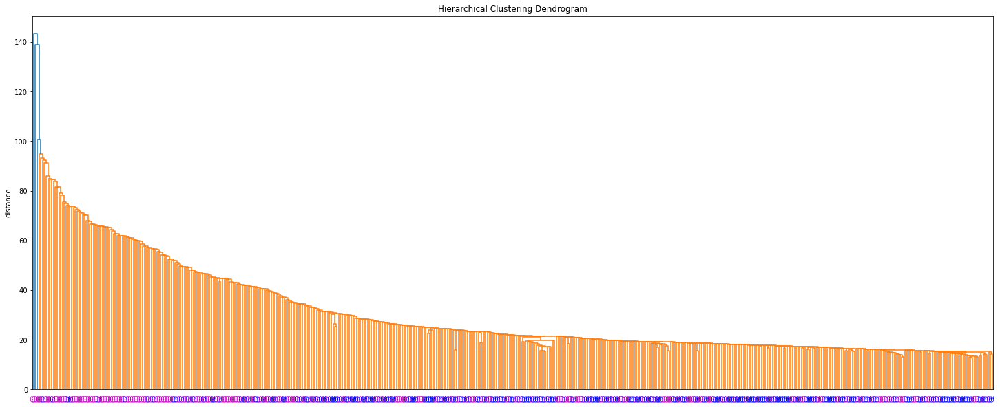

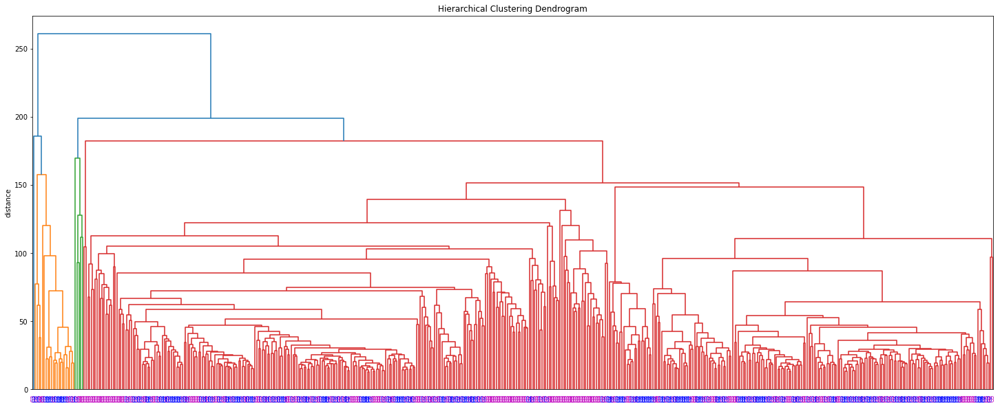

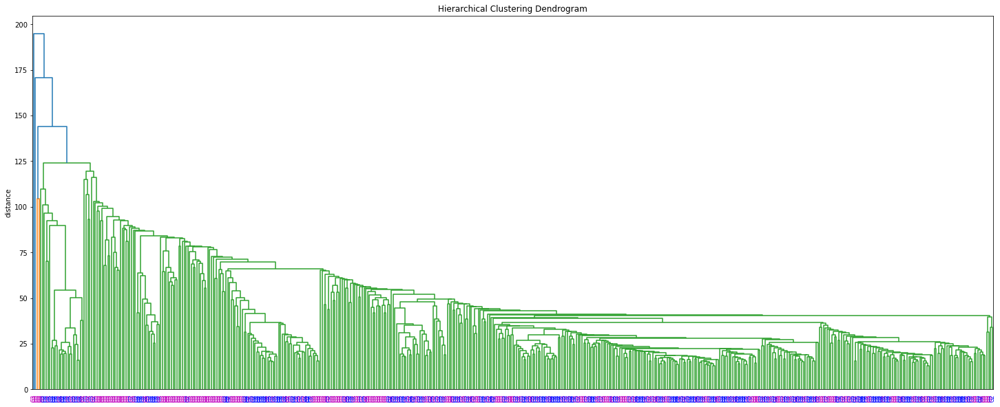

In [97]:
from scipy.cluster.hierarchy import dendrogram, linkage

# linkage single
Z = linkage(agg_data, method='single', metric='euclidean')

plt.figure(figsize=(25, 10))
dendrogram(Z, labels=np.array(agg_data.index.get_level_values(1).tolist()),leaf_rotation=90., leaf_font_size=8.)
plt.title('Hierarchical Clustering Dendrogram')
plt.ylabel('distance')
lcolors = {'G2':'b', "G3":"m"}
ax = plt.gca()
xlbls = ax.get_xmajorticklabels()
for lbl in xlbls:
  lbl.set_color(lcolors[lbl.get_text()])
plt.show()

# linkage complete
Z = linkage(agg_data, method='complete', metric='euclidean')

plt.figure(figsize=(25, 10))
dendrogram(Z, labels=np.array(agg_data.index.get_level_values(1).tolist()),leaf_rotation=90., leaf_font_size=8.)
plt.title('Hierarchical Clustering Dendrogram')
plt.ylabel('distance')
lcolors = {'G2':'b', "G3":"m"}
ax = plt.gca()
xlbls = ax.get_xmajorticklabels()
for lbl in xlbls:
  lbl.set_color(lcolors[lbl.get_text()])
plt.show()

# linkage average
Z = linkage(agg_data, method='average', metric='euclidean')

plt.figure(figsize=(25, 10))
dendrogram(Z, labels=np.array(agg_data.index.get_level_values(1).tolist()),leaf_rotation=90., leaf_font_size=8.)
plt.title('Hierarchical Clustering Dendrogram')
plt.ylabel('distance')
lcolors = {'G2':'b', "G3":"m"}
ax = plt.gca()
xlbls = ax.get_xmajorticklabels()
for lbl in xlbls:
  lbl.set_color(lcolors[lbl.get_text()])
plt.show()

Através dos resultados obtidos do dendogramas apresentados, verifica-se que o método de linkage mais adequado para os dados é o _complete_. Isto poderá remeter para _clusters_ distintos e compactos, onde os dados dentro dos _clusters_ são mais semelhantes entre si do que entre _clusters_, pois a dissimilaridade entre estes é efetuada pela distância máxima entre pontos destes.

Adicionalmente, tal informação pode indicar a presença de formas irregulares e tamanhos variados.

Conclui-se que existe uma distinção clara inicial em dois grupos, apontando para dois _clusters_ bastante distintos, com similaridades altas entre amostras dentro de cada um, observável através das ramificações curtas, porém com elevado nível de ramificação, indicando alguma complexidade nos dados.

In [68]:
hclust = AgglomerativeClustering(n_clusters=2, affinity="euclidean", linkage="complete")
labels = hclust.fit_predict(dg_final_genes)

In [69]:
output_grade = dg_final.values[:,1] 
res_hc = hclust.labels_
pd.crosstab(output_grade, res_hc)

col_0,0,1
row_0,,
G2,258,0
G3,270,1


Aqui, pode ser averiguado que as suspeitas anteriores se poderão confirmar, havendo, efetivamente uma segmentação em 2 _clusters_ distintos, sendo, porém, quase a totalidade dos dados agrupados num só _cluster_, indicando a falta de capacidade de distinção das classes de acordo com os atributos.

#### KMeans

KMeans é um algoritmo de agregação de dados em _clusters_, tendo como principal finalidade dividir um conjunto de dados em grupos distintos, onde os membros de um mesmo _cluster_ são mais similares entre si do que com membros de outros _clusters_.

À semelhança do processo anterior, foi selecionado como atributo alvo o atributo _GRADE_, definindo assim um valor de k=2, estabelecendo que existem 2 _clusters_ relativos ao grau de agressividade dos gliomas (G2 e G3).

In [77]:
k=2
kmeans_har = KMeans(n_clusters=k, max_iter=1000, n_init = 10)
kmeans_har.fit(dg_final_genes)
labels = kmeans_har.labels_
centroids = kmeans_har.cluster_centers_
pd.crosstab(labels, merged_df["GRADE"], rownames=['clusters'] )

GRADE,G2,G3
clusters,,
0,248,181
1,10,90


Segundo os resultados obtidos, ter-se-ia dois _clusters_ distintos e bem definidos, não apontando assim para qualquer indicío de erro. Porém, para confirmar se estes resultados seriam fidedignos, foi efetuado o gráfico com a respresentação dos mesmos.

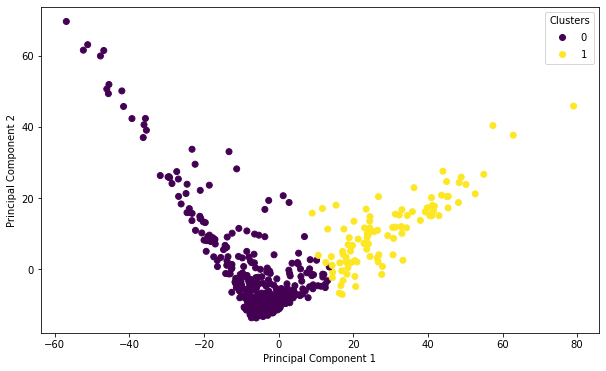

In [92]:
pca = PCA(n_components=2)
dg_pca = pca.fit_transform(dg_final_genes)

dg_pca_df = pd.DataFrame(dg_pca, columns=['Principal Component 1', 'Principal Component 2'])

dg_pca_df['Cluster'] = labels

plt.figure(figsize=(10, 6))
scatter = plt.scatter(dg_pca_df['Principal Component 1'], dg_pca_df['Principal Component 2'], c=dg_pca_df['Cluster'], cmap='viridis')

plt.legend(*scatter.legend_elements(), title='Clusters')

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.show()


Observando o gráfico obtido e o gráfico apresentado anteriormente, relativamente à dispersão dos dados, averiguamos que, apesar de existir uma boa divisão dos _clusters_, estes não representam corretamente o dataset avaliado. Não podendo assim, tirar conclusões a partir destes resultados.

Em suma, efetuado o _clustering_ recorrendo ao método KMeans, averigua-se que as conclusões tiradas relativamente ao _hierarchical clustering_ estão alinhadas com os resultados obtidos. Porém, obtiveram-se _clusters_ não correspondentes à realidade, podendo remeter para a conclusão de que o método KMeans poderá não ser o mais adequado.

## Secção 3

### Aprendizagem Supervisionada

A aprendizagem supervisionada é um paradigma de ML, onde um modelo é treinado usando um conjunto de dados rotulados, ou seja, um conjunto de dados em que a cada linha tem associado um rótulo referente ao atributo alvo. O objetivo da aprendizagem supervisionada é aprender através das relações entre os dados e o desfecho, de modo a que o modelo possa fazer previsões ou classificações precisas para novos dados não rotulados.

Nesta secção, havia por objetivo, procurar obter um modelo de aprendizagem que permitisse identificar corretamente o grau de glioma, de modo a permitir a intervenção atempada e eficaz, por parte da equipa médica. Para tal, foram analisados 4 algoritmos de aprendizagem (Árvores de Decisão/ _Decision Tree_, _Random Forest_,_Naive Bayes_ e _Support Vector Machine_ (SVM). Foram, também, analisados os valores obtidos recorrendo aos métodos de partição _Split Data_ e _Cross Validation_.

#### Split-Data

In [136]:
X = pd.get_dummies(merged_df.drop("GRADE", axis=1))
y = merged_df["GRADE"]

train_in, test_in, train_out, test_out = train_test_split(X, y, test_size=0.3, random_state=42)

print(train_in.shape)
print(train_out.shape)

print(test_in.shape)
print(test_out.shape)

(370, 1700)
(370,)
(159, 1700)
(159,)


##### Decision Tree - DT

In [137]:
modelo_arvore = DecisionTreeClassifier(random_state=42)
modelo_arvore.fit(train_in, train_out)

predicoes = modelo_arvore.predict(test_in)
matriz_confusao=confusion_matrix(test_out, predicoes)


In [151]:
accuracy=accuracy_score(test_out, predicoes)

# Classes
classes = ["G2", "G3"]

# Matriz de confusão
matriz_confusao = confusion_matrix(test_out, predicoes, labels=classes)

# Precision, recall e f1-score
precision_por_classe = []
recall_por_classe = []
f1_por_classe = []

for i, classe in enumerate(classes):
    precision_classe = precision_score(test_out, predicoes, labels=[classe], average='micro')
    recall_classe = recall_score(test_out, predicoes, labels=[classe], average='micro')
    f1_classe = f1_score(test_out, predicoes, labels=[classe], average='micro')
    
    precision_por_classe.append(precision_classe)
    recall_por_classe.append(recall_classe)
    f1_por_classe.append(f1_classe)
    
# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'Classe: {classe}')
    print(f'Precision: {precision_por_classe[i]*100:.2f} %')
    print(f'Recall: {recall_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('Matriz de Confusão:')
print(matriz_confusao)
print(f'\nAccuracy: {accuracy*100:.2f} %')

Classe: G2
Precision: 86.25 %
Recall: 82.14 %
F1-Score: 84.15 %
---
Classe: G3
Precision: 81.01 %
Recall: 85.33 %
F1-Score: 83.12 %
---
Matriz de Confusão:
[[69 15]
 [11 64]]

Accuracy: 83.65 %


ROC AUC (Decision Tree): 0.8374


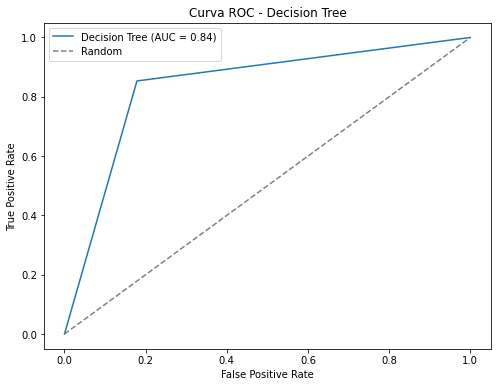

In [110]:
from sklearn.metrics import roc_curve, auc
# Curva ROC
y_prob_arvore = modelo_arvore.predict_proba(test_in)[:, 1]

# Calcular a Curva ROC
fpr_arvore, tpr_arvore, thresholds_arvore = roc_curve(test_out, y_prob_arvore, pos_label='G3')
roc_auc_arvore = auc(fpr_arvore, tpr_arvore)

# Exibir a Curva ROC
print(f'ROC AUC (Decision Tree): {roc_auc_arvore:.4f}')


plt.figure(figsize=(8, 6))
plt.plot(fpr_arvore, tpr_arvore, label=f'Decision Tree (AUC = {roc_auc_arvore:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC - Decision Tree')
plt.legend()
plt.show()

##### Random Forest - RF

In [146]:
modeloRF = RandomForestClassifier(random_state=42)

modeloRF.fit(train_in, train_out)

previsaoRF = modeloRF.predict(test_in)

cm = confusion_matrix(test_out, previsaoRF)

In [153]:
accuracy=accuracy_score(test_out, previsaoRF)

# Classes
classes = ["G2", "G3"]

# Matriz de confusão
matriz_confusao = confusion_matrix(test_out, previsaoRF, labels=classes)

# Precision, recall e f1-score
precision_por_classe = []
recall_por_classe = []
f1_por_classe = []

for i, classe in enumerate(classes):
    precision_classe = precision_score(test_out, previsaoRF, labels=[classe], average='micro')
    recall_classe = recall_score(test_out, previsaoRF, labels=[classe], average='micro')
    f1_classe = f1_score(test_out, previsaoRF, labels=[classe], average='micro')
    
    precision_por_classe.append(precision_classe)
    recall_por_classe.append(recall_classe)
    f1_por_classe.append(f1_classe)
    
# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'Classe: {classe}')
    print(f'Precision: {precision_por_classe[i]*100:.2f} %')
    print(f'Recall: {recall_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('Matriz de Confusão:')
print(matriz_confusao)
print(f'\nAccuracy: {accuracy*100:.2f} %')

Classe: G2
Precision: 77.65 %
Recall: 78.57 %
F1-Score: 78.11 %
---
Classe: G3
Precision: 75.68 %
Recall: 74.67 %
F1-Score: 75.17 %
---
Matriz de Confusão:
[[66 18]
 [19 56]]

Accuracy: 76.73 %


ROC AUC (Random Forest): 0.8382


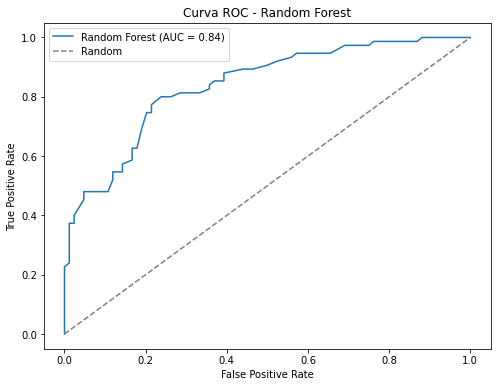

In [113]:
# Probabilidades previstas para a classe positiva (classe 'G3')
y_prob_rf = modeloRF.predict_proba(test_in)[:, 1]

fpr_rf, tpr_rf, thresholds_rf = roc_curve(test_out, y_prob_rf, pos_label='G3')
roc_auc_rf = auc(fpr_rf, tpr_rf)

print(f'ROC AUC (Random Forest): {roc_auc_rf:.4f}')

plt.figure(figsize=(8, 6))
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {roc_auc_rf:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC - Random Forest')
plt.legend()
plt.show()

##### Naive Bayes - NB

In [114]:
modeloNB = GaussianNB()

modeloNB.fit(train_in, train_out)

previsoesNB = modeloNB.predict(test_in)

cm = confusion_matrix(test_out, previsoesNB)

In [154]:
# Accuracy
accuracy=accuracy_score(test_out, previsoesNB)

# Classes
classes = ["G2", "G3"]

# Matriz de confusão
matriz_confusao = confusion_matrix(test_out, previsoesNB, labels=classes)

# Precision, recall e f1-score
precision_por_classe = []
recall_por_classe = []
f1_por_classe = []

for i, classe in enumerate(classes):
    precision_classe = precision_score(test_out, previsoesNB, labels=[classe], average='micro')
    recall_classe = recall_score(test_out, previsoesNB, labels=[classe], average='micro')
    f1_classe = f1_score(test_out, previsoesNB, labels=[classe], average='micro')
    
    precision_por_classe.append(precision_classe)
    recall_por_classe.append(recall_classe)
    f1_por_classe.append(f1_classe)
    
# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'Classe: {classe}')
    print(f'Precision: {precision_por_classe[i]*100:.2f} %')
    print(f'Recall: {recall_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('Matriz de Confusão:')
print(matriz_confusao)
print(f'\nAccuracy: {accuracy*100:.2f} %')

Classe: G2
Precision: 89.16 %
Recall: 88.10 %
F1-Score: 88.62 %
---
Classe: G3
Precision: 86.84 %
Recall: 88.00 %
F1-Score: 87.42 %
---
Matriz de Confusão:
[[74 10]
 [ 9 66]]

Accuracy: 88.05 %


ROC AUC (Random Forest): 0.8865


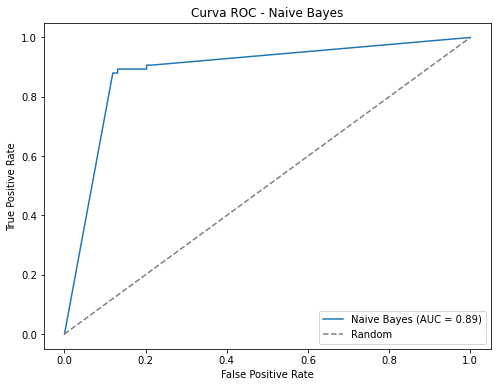

In [116]:
y_prob_nb = modeloNB.predict_proba(test_in)[:, 1]

fpr_nb, tpr_nb, thresholds_rf = roc_curve(test_out, y_prob_nb, pos_label='G3')
roc_auc_nb = auc(fpr_nb, tpr_nb)

print(f'ROC AUC (Random Forest): {roc_auc_nb:.4f}')

plt.figure(figsize=(8, 6))
plt.plot(fpr_nb, tpr_nb, label=f'Naive Bayes (AUC = {roc_auc_nb:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC - Naive Bayes')
plt.legend()
plt.show()

##### Support Vector Machine - SVM

In [117]:
modelo_SVM = SVC(probability=True, random_state=42)

modelo_SVM.fit(train_in, train_out)

previsoes_SVM = modelo_SVM.predict(test_in)

cm = confusion_matrix(test_out, previsoes_SVM)

In [155]:
# Accuracy
accuracy=accuracy_score(test_out, previsoes_SVM)

# Classes
classes = ["G2", "G3"]

# Matriz de confusão
matriz_confusao = confusion_matrix(test_out, previsoes_SVM, labels=classes)

# Precision, recall e f1-score
precision_por_classe = []
recall_por_classe = []
f1_por_classe = []

for i, classe in enumerate(classes):
    precision_classe = precision_score(test_out, previsoes_SVM, labels=[classe], average='micro')
    recall_classe = recall_score(test_out, previsoes_SVM, labels=[classe], average='micro')
    f1_classe = f1_score(test_out, previsoes_SVM, labels=[classe], average='micro')
    
    precision_por_classe.append(precision_classe)
    recall_por_classe.append(recall_classe)
    f1_por_classe.append(f1_classe)
    
# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'Classe: {classe}')
    print(f'Precision: {precision_por_classe[i]*100:.2f} %')
    print(f'Recall: {recall_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('Matriz de Confusão:')
print(matriz_confusao)
print(f'\nAccuracy: {accuracy*100:.2f} %')

Classe: G2
Precision: 67.96 %
Recall: 83.33 %
F1-Score: 74.87 %
---
Classe: G3
Precision: 75.00 %
Recall: 56.00 %
F1-Score: 64.12 %
---
Matriz de Confusão:
[[70 14]
 [33 42]]

Accuracy: 70.44 %


ROC AUC (Support Vector Machine): 0.7652


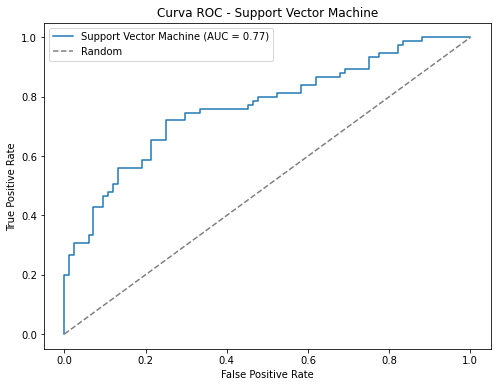

In [119]:
y_prob_svm = modelo_SVM.predict_proba(test_in)[:, 1]

fpr_svm, tpr_svm, thresholds_svm = roc_curve(test_out, y_prob_svm, pos_label='G3')
roc_auc_svm = auc(fpr_svm, tpr_svm)

print(f'ROC AUC (Support Vector Machine): {roc_auc_svm:.4f}')

plt.figure(figsize=(8, 6))
plt.plot(fpr_svm, tpr_svm, label=f'Support Vector Machine (AUC = {roc_auc_svm:.2f})')  # Use fpr_svm and tpr_svm here
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC - Support Vector Machine')
plt.legend()
plt.show()

### Cross-Validation

##### Decision Tree - DT

In [120]:
X = pd.get_dummies(merged_df.drop("GRADE", axis=1))
y = merged_df["GRADE"]

modelo_DT_CV = DecisionTreeClassifier()

previsoes_DT_CV = cross_val_predict(modelo_DT_CV, X, y, cv=5)

In [159]:
# Matriz de confusão
matriz_confusao_CV = confusion_matrix(y, previsoes_DT_CV)

precisiones_por_classe = []
recalls_por_classe = []
f1_scores_por_classe = []

# Calcula precision, recall e f1-score para cada classe
classes = pd.unique(y)
for i, classe in enumerate(classes):
    precision_classe = precision_score(y, previsoes_DT_CV, labels=[classe], average='micro')
    recall_classe = recall_score(y, previsoes_DT_CV, labels=[classe], average='micro')
    f1_classe = f1_score(y, previsoes_DT_CV, labels=[classe], average='micro')

    precisiones_por_classe.append(precision_classe)
    recalls_por_classe.append(recall_classe)
    f1_scores_por_classe.append(f1_classe)

# Accuracy
acuracia_media = (matriz_confusao_CV[0, 0] + matriz_confusao_CV[1, 1]) / matriz_confusao_CV.sum()

# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'\nClasse: {classe}')
    print(f'Precision: {precisiones_por_classe[i]*100:.2f} %')
    print(f'Recall: {recalls_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_scores_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('\nMatriz de Confusão (CV):')
print(matriz_confusao_CV)
print(f"Accuracy: {acuracia_media*100:.2f} %")


Classe: G3
Precision: 88.36 %
Recall: 89.67 %
F1-Score: 89.01 %
---

Classe: G2
Precision: 88.98 %
Recall: 87.60 %
F1-Score: 88.28 %
---

Matriz de Confusão (CV):
[[226  32]
 [ 28 243]]
Accuracy: 88.66 %


##### Random Forest - RF

In [122]:
modelo_RF_CV = RandomForestClassifier()

previsoes_RF_CV = cross_val_predict(modelo_RF_CV, X, y, cv=5)

In [160]:
# Matriz de confusão
matriz_confusao_CV = confusion_matrix(y, previsoes_RF_CV)

precisiones_por_classe = []
recalls_por_classe = []
f1_scores_por_classe = []

# Calcula precision, recall e f1-score para cada classe
classes = pd.unique(y)
for i, classe in enumerate(classes):
    precision_classe = precision_score(y, previsoes_RF_CV, labels=[classe], average='micro')
    recall_classe = recall_score(y, previsoes_RF_CV, labels=[classe], average='micro')
    f1_classe = f1_score(y, previsoes_RF_CV, labels=[classe], average='micro')

    precisiones_por_classe.append(precision_classe)
    recalls_por_classe.append(recall_classe)
    f1_scores_por_classe.append(f1_classe)

# Accuracy
acuracia_media = (matriz_confusao_CV[0, 0] + matriz_confusao_CV[1, 1]) / matriz_confusao_CV.sum()

# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'\nClasse: {classe}')
    print(f'Precision: {precisiones_por_classe[i]*100:.2f} %')
    print(f'Recall: {recalls_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_scores_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('\nMatriz de Confusão (CV):')
print(matriz_confusao_CV)
print(f"Accuracy: {acuracia_media*100:.2f} %")


Classe: G3
Precision: 77.24 %
Recall: 70.11 %
F1-Score: 73.50 %
---

Classe: G2
Precision: 71.38 %
Recall: 78.29 %
F1-Score: 74.68 %
---

Matriz de Confusão (CV):
[[202  56]
 [ 81 190]]
Accuracy: 74.10 %


#### Naive Bayes - NB

In [124]:
modelo_NB_CV = GaussianNB()

previsoes_NB_CV = cross_val_predict(modelo_NB_CV, X, y, cv=5)

In [161]:
# Matriz de confusão
matriz_confusao_CV = confusion_matrix(y, previsoes_NB_CV)

precisiones_por_classe = []
recalls_por_classe = []
f1_scores_por_classe = []

# Calcula precision, recall e f1-score para cada classe
classes = pd.unique(y)
for i, classe in enumerate(classes):
    precision_classe = precision_score(y, previsoes_NB_CV, labels=[classe], average='micro')
    recall_classe = recall_score(y, previsoes_NB_CV, labels=[classe], average='micro')
    f1_classe = f1_score(y, previsoes_NB_CV, labels=[classe], average='micro')

    precisiones_por_classe.append(precision_classe)
    recalls_por_classe.append(recall_classe)
    f1_scores_por_classe.append(f1_classe)

# Accuracy
acuracia_media = (matriz_confusao_CV[0, 0] + matriz_confusao_CV[1, 1]) / matriz_confusao_CV.sum()

# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'\nClasse: {classe}')
    print(f'Precision: {precisiones_por_classe[i]*100:.2f} %')
    print(f'Recall: {recalls_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_scores_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('\nMatriz de Confusão (CV):')
print(matriz_confusao_CV)
print(f"Accuracy: {acuracia_media*100:.2f} %")


Classe: G3
Precision: 88.01 %
Recall: 86.72 %
F1-Score: 87.36 %
---

Classe: G2
Precision: 86.26 %
Recall: 87.60 %
F1-Score: 86.92 %
---

Matriz de Confusão (CV):
[[226  32]
 [ 36 235]]
Accuracy: 87.15 %


#### Support Vector Machine - SVM

In [126]:
modelo_SVM_CV = SVC(probability=True, random_state=42)

previsoes_SVC_CV = cross_val_predict(modelo_SVM_CV, X, y, cv=5)

In [162]:
# Matriz de confusão
matriz_confusao_CV = confusion_matrix(y, previsoes_SVC_CV)

precisiones_por_classe = []
recalls_por_classe = []
f1_scores_por_classe = []

# Calcula precision, recall e f1-score para cada classe
classes = pd.unique(y)
for i, classe in enumerate(classes):
    precision_classe = precision_score(y, previsoes_SVC_CV, labels=[classe], average='micro')
    recall_classe = recall_score(y, previsoes_SVC_CV, labels=[classe], average='micro')
    f1_classe = f1_score(y, previsoes_SVC_CV, labels=[classe], average='micro')

    precisiones_por_classe.append(precision_classe)
    recalls_por_classe.append(recall_classe)
    f1_scores_por_classe.append(f1_classe)

# Accuracy
acuracia_media = (matriz_confusao_CV[0, 0] + matriz_confusao_CV[1, 1]) / matriz_confusao_CV.sum()

# Exibe as métricas por classe
for i, classe in enumerate(classes):
    print(f'\nClasse: {classe}')
    print(f'Precision: {precisiones_por_classe[i]*100:.2f} %')
    print(f'Recall: {recalls_por_classe[i]*100:.2f} %')
    print(f'F1-Score: {f1_scores_por_classe[i]*100:.2f} %')
    print('---')

# Exibe a matriz de confusão e a accuracy
print('\nMatriz de Confusão (CV):')
print(matriz_confusao_CV)
print(f"Accuracy: {acuracia_media*100:.2f} %")


Classe: G3
Precision: 84.36 %
Recall: 55.72 %
F1-Score: 67.11 %
---

Classe: G2
Precision: 65.71 %
Recall: 89.15 %
F1-Score: 75.66 %
---

Matriz de Confusão (CV):
[[230  28]
 [120 151]]
Accuracy: 72.02 %


Tendo em conta os resultados obtidos, conclui-se que o modelo com melhor desempenho foi o de partição _Cross Validation_ associado ao algoritmo de aprendizagem _Decision Tree_. 

Neste modelo foi obtido um valor de _accuracy_ de cerca de 88,66%, o que refelte uma elevada taxa de acerto nas previsões em geral.

Adicionalmente, os valores de _precision_ e _recall_ são relativamente altos, indicando que o modelo foi capaz de equilibrar bem a precisão na classificação e identificação eficaz dos graus de agressividade dos gliomas.

### Conclusão

Deste modo, conlcui-se que o modelo é capaz de identificar com sucesso as instâncias das classes G2 e G3, demonstrando sua utilidade para o objetivo inicial proposto.

Contudo, este modelo poderá ou não apresentar um desempenho menos satisfatório com uma maior quantidade de dados, revelando comportamentos diferentes dos identificados neste estudo. 

Como projetos de melhoria futuros, tem-se a possibilidade de testagem e ajuste do modelo com um dataset mais extenso, assim como a possibilidade de classificação de não só 2 graus de glioma, mas os 4 existentes.

### Bibliografia

[1] Franco, G., & Silva, J. (2021). Gliomas: Current Classification and Genetic Alterations. Journal of Neuroscience Research, 1-15. Recuperado de https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8332856/

[2] “Tudo sobre glioblastoma: sobrevida e tratamento!,” Neurocirurgia e Tratamento para Dor em SP, Apr. 23, 2022. https://neurocirurgiasp.com.br/artigos/dores/glioblastoma/

[3] Santos, B. A. dos, Araújo, I. L., Brito, J. N. P. de O., Ibiapina, J. O., & Zeron, R. M. C. (2018). Auxílio dos Marcadores Imuno-Histoquímico e Molecular na Classificação e Condução de Gliomas Difusos de Baixo Grau de Malignidade. Jornal Brasileiro de Neurocirurgia, Volume(Issue), 13-17.

[4] X. Shi et al., “Functions of idh1 and its mutation in the regulation of developmental hematopoiesis in zebrafish,” Blood, vol. 125, no. 19, pp. 2974–2984, May 2015, doi: https://doi.org/10.1182/blood-2014-09-601187

[5] “Cic capicua transcriptional repressor [Mus musculus (house mouse)] - Gene - NCBI,” www.ncbi.nlm.nih.gov. https://www.ncbi.nlm.nih.gov/gene/71722 (accessed Jan. 28, 2024)

[6] Medline Plus, “TP53 gene: MedlinePlus Genetics,” medlineplus.gov, Aug. 18, 2020. https://medlineplus.gov/genetics/gene/tp53/

[7] “NOTCH1 gene: MedlinePlus Genetics,” medlineplus.gov. https://medlineplus.gov/genetics/gene/notch1/

[8] N. Fusco et al., “PIK3CA Mutations as a Molecular Target for Hormone Receptor-Positive, HER2-Negative Metastatic Breast Cancer,” Frontiers in Oncology, vol. 11, Mar. 2021, doi: https://doi.org/10.3389/fonc.2021.644737

[9] “WHO Grade II Glioma - My Cancer Genome,” Mycancergenome.org, 2018. https://www.mycancergenome.org/content/disease/who-grade-ii-glioma/ (accessed Jan. 28, 2024)

[10] “UniProt,” www.uniprot.org. https://www.uniprot.org/uniprotkb/P46100/entry (accessed Jan. 28, 2024)

[11] “UniProt,” www.uniprot.org. https://www.uniprot.org/uniprotkb/P42771/entry

[12] “WHO Grade III Glioma - My Cancer Genome,” Mycancergenome.org, 2018. https://www.mycancergenome.org/content/disease/who-grade-iii-glioma/ (accessed Jan. 28, 2024)

[13] Zhou Y, Tan Z, Chen K, Wu W, Zhu J, Wu G, Cao L, Zhang X, Zeng X, Li J, Zhang W. Overexpression of SHCBP1 promotes migration and invasion in gliomas by activating the NF-κB signaling pathway. Mol Carcinog. 2018 Sep;57(9):1181-1190. doi: 10.1002/mc.22834. Epub 2018 May 18. PMID: 29745440.

[14] Zhu H, Ouyang H, Pan X, Zhang Z, Tan J, Yu N, Li M, Zhao Y. Increased ASF1B Expression Correlates With Poor Prognosis in Patients With Gliomas. Front Oncol. 2022 Jul 6;12:912101. doi: 10.3389/fonc.2022.912101. PMID: 35875094; PMCID: PMC9298524.

[15] Z. Xia et al., “AURKA Governs Self-Renewal Capacity in Glioma-Initiating Cells via Stabilization/Activation of β-catenin/Wnt Signaling,” Molecular Cancer Research, vol. 11, no. 9, pp. 1101–1111, Sep. 2013, doi: https://doi.org/10.1158/1541-7786.mcr-13-0044.

[16] Sun H, Yang B, Zhang H, Song J, Zhang Y, Xing J, Yang Z, Wei C, Xu T, Yu Z, Xu Z, Hou M, Ji M, Zhang Y. RRM2 is a potential prognostic biomarker with functional significance in glioma. Int J Biol Sci. 2019 Jan 1;15(3):533-543. doi: 10.7150/ijbs.30114. PMID: 30745840; PMCID: PMC6367584.